# Introdução

Esse projeto consiste no desenvolvimento de modelos de aprendizado de máquina supervisionados de classificação que tem como objetivo prever corretamente se o cliente comprou ou não uma determinada residência. Os algoritmos de Machine Learning utilizaram de informações sobre as propriedades e os indivíduos para realizarem essas classificações, presentes na base de dados em um arquivo CSV retirada da plataforma Kaggle, que pode ser acessada através do link abaixo:

https://www.kaggle.com/datasets/mohankrishnathalla/global-house-purchase-decision-dataset/data

Para que seja alcançado seu objetivo principal, esse projeto de ciência de dados foi separado em 4 etapas principais que buscam aprofundar na compreensão e entendimento das informações disponíveis e permitir que o código seja bem estruturado, completo e organizado. Essas 4 etapas são: 

* **Análise Exploratória dos Dados (EDA)**: Nessa parte inicial, é feito o carregamento da base de dados, a verificação das variáveis existentes e quais as informações elas providenciam, a correção de qualquer incoerências e inconsistência e a identificação e tratamento de "outliers".

* **Pré-Processamento**: Momento em que os dados são alterados e adequados aos parâmetros que os modelos de aprendizado demandam para o seu eficaz funcionamento e processamento: variáveis categóricas são codificadas, os dados são padronizados, a variável alvo é separada das restantes, bases de treino e teste são criadas, com a base de treino recebendo balanceamento, além da análise de correlação das informações para garantir que os modelos recebem apenas os dados que possuem alguma relevância para o objetivo.

* **Modelagem**: Etapa em que ocorre a criação de instâncias dos modelos de "Machine Learning", realizando o treinamento dos algoritmos para identificação de padrões e entendimento das informações e, posteriormente, teste esse aprendizado em dados inéditos.

* **Avaliação**: Aplicação de diferentes métricas comuns e confiáveis para analisar o desempenho de cada modelos apresentado, os obstáculos que foram encontrados e qual foi o mais eficiente para o objetivo do projeto.

### Variáveis

* **property_id**: ID da propriedade ou residência

* **country**: País onde se encontra a residência

* **city**: Cidade onde se encontra a residência

* **property_type**: Tipo de residência

* **furnishing_status**: Se está mobiliada, semi-mobiliada ou sem mobília

* **property_size_sqft**: Tamanho em pés quadrados da residência

* **price**: Preço da residência

* **constructed_year**: Ano de construção da residência

* **previous_owners**: Quantidade de donos anteriores da residência

* **rooms**: Quantidade de quartos da residência

* **bathrooms**: Quantidade de banheiros da residência

* **garage**: Se tem garagem (0: Não, 1: Sim)

* **garden**: Se tem jardim (0: Não, 1: Sim)

* **crime_cases_reported**: Quantidade de casos criminosos reportados perto da residência

* **legal_cases_on_property**: Se há conflito jurídico ocorrendo na residência (0: Não, 1: Sim)

* **customer_salary**: Salário do cliente/comprador

* **loan_amount**: Quantidade de empréstimo planejado a ser feito

* **loan_tenure_years**: Prazo para pagamento do empréstimo em anos

* **monthly_expenses**: Custos mensais do comprador

* **down_payment**: Pagamento adiantado feito

* **emi_to_income_ratio**: Porcentagem da renda mensal destinada a pagar parcelas de empréstimos, financiamentos e outros débitos. 

* **satisfaction_score**: Pontuação de satisfação do cliente/comprador (1-10)

* **neighbourhood_rating**: Avaliação da vizinhança (Segurança, conveniência, localizada perto de escolas) (1-10)

* **connectivity_score**: Avaliação da conectividade (Acesso a transporte público, internet de boa qualidade, etc.) (1-10)

#### Variável Alvo:
* **decision**: Se o cliente comprou a residência ou não (0: Não, 1: Sim)

# Projeto:

## Importações

In [1]:
# Importações de bibliotecas para manipulação e visualização de dados

import pandas as pd  # Importa pandas para manipulação de dados
import seaborn as sns # Importa seaborn para visualização de dados
import numpy as np # Importa numpy para operações numéricas
import matplotlib.pyplot as plt # Importa matplotlib para visualização de dados
import plotly.figure_factory as ff # Importa figure_factory para criar gráficos personalizados
import plotly.express as px # Importa plotly para visualização interativa

# Importações de bibliotecas para pré-processamento de dados e avaliação de modelos

from imblearn.over_sampling import SMOTE # Importa SMOTE para balanceamento de classes
from sklearn.preprocessing import StandardScaler # Importa StandardScaler para padronização de dados
from sklearn.model_selection import KFold, train_test_split, cross_val_score # Importa funções para divisão de dados e validação cruzada
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, roc_auc_score # Importa métricas de avaliação de modelos

# Importações de bibliotecas para modelagem preditiva

import xgboost as xgb # Importa XGBoost para modelagem preditiva
from sklearn.linear_model import LogisticRegression # Importa regressão logística para modelagem preditiva

## Análise Exploratória dos Dados

### Carregamento da Base

In [2]:
df = pd.read_csv('global_house_purchase_dataset.csv') # Carrega o conjunto de dados de compra de residências em um DataFrame

display(df) # Exibe o DataFrame carregado para inspeção inicial

,property_id,country,city,property_type,furnishing_status,property_size_sqft,price,constructed_year,previous_owners,rooms,...,customer_salary,loan_amount,loan_tenure_years,monthly_expenses,down_payment,emi_to_income_ratio,satisfaction_score,neighbourhood_rating,connectivity_score,decision
0,1,France,Marseille,Farmhouse,Semi-Furnished,991,412935,1989,6,6,...,10745,193949,15,6545,218986,0.16,1,5,6,0
1,2,South Africa,Cape Town,Apartment,Semi-Furnished,1244,224538,1990,4,8,...,16970,181465,20,8605,43073,0.08,9,1,2,0
2,3,South Africa,Johannesburg,Farmhouse,Semi-Furnished,4152,745104,2019,5,2,...,21914,307953,30,2510,437151,0.09,6,8,1,0
3,4,Germany,Frankfurt,Farmhouse,Semi-Furnished,3714,1110959,2008,1,3,...,17980,674720,15,8805,436239,0.33,2,6,6,0
4,5,South Africa,Johannesburg,Townhouse,Fully-Furnished,531,99041,2007,6,3,...,17676,65833,25,8965,33208,0.03,3,3,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,199996,Germany,Berlin,Villa,Fully-Furnished,685,203328,1968,1,3,...,78330,104050,15,17670,99278,0.01,8,4,5,1
199996,199997,China,Shenzhen,Townhouse,Unfurnished,3818,1454627,1977,5,7,...,25400,1175297,20,2865,279330,0.34,7,10,9,1
199997,199998,Japan,Kyoto,Villa,Semi-Furnished,3603,1619147,1990,2,4,...,28220,743049,30,5595,876098,0.17,5,3,9,0
199998,199999,South Africa,Johannesburg,Apartment,Unfurnished,1706,306165,2010,0,4,...,12240,150774,15,16300,155391,0.11,6,10,6,0


### Filtragem Inicial e Verificação de Valores Nulos

In [3]:
df = df.drop('property_id', axis=1) # Remove a coluna 'property_id' do DataFrame, desnecessária para análise

df.info() # Exibe informações sobre o DataFrame, incluindo tipos de dados e contagem de valores não nulos

print("----------------")
print(f"Valores Nulos: {df.isna().sum().sum()}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 24 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   country                  200000 non-null  object 
 1   city                     200000 non-null  object 
 2   property_type            200000 non-null  object 
 3   furnishing_status        200000 non-null  object 
 4   property_size_sqft       200000 non-null  int64  
 5   price                    200000 non-null  int64  
 6   constructed_year         200000 non-null  int64  
 7   previous_owners          200000 non-null  int64  
 8   rooms                    200000 non-null  int64  
 9   bathrooms                200000 non-null  int64  
 10  garage                   200000 non-null  int64  
 11  garden                   200000 non-null  int64  
 12  crime_cases_reported     200000 non-null  int64  
 13  legal_cases_on_property  200000 non-null  int64  
 14  cust

Após verificar as variáveis da base de dados carregada, a coluna de "property_id" foi retirada nessa filtragem inicial, pois se trata de uma variável utilizada apenas para a identificação única de cada residência em formato numérico e não tem um significado real para o objetivo de classificar corretamente se o cliente comprou ou não a residência. Assim, para evitar desafios e problemas na etapa de processamento dos modelos, essa informação foi descartada.

Utilizando a função "info()", foi possível identificar as variáveis quantitativas (numéricas) e as qualitativas (em formato de texto, categóricas), além de um resumo da quantidade de colunas na base de dados e do total de casos existentes. Com isso, foi possível verificar que não havia nenhum valor faltante e que todas as variáveis estavam de acordo com seus "dtypes" esperados, ou seja, não havia preenchimento de espaços vazios ou alteração de tipagem que precisavam serem feitos.

### Valores das Variáveis Qualitativas

In [4]:
df_cidade = df['city'].value_counts().sort_index(ascending=True) # Conta a frequência de cada cidade e ordena por nome da cidade

df_cidade = df_cidade.reset_index(name='Contagem').rename(columns={'index': 'Cidade'}) # Reseta o índice e renomeia as colunas para melhor clareza

df_cidade # Exibe o DataFrame com a contagem de residências por cidade

,city,Contagem
0,Abu Dhabi,7504
1,Bangalore,2579
2,Beijing,5328
3,Berlin,5241
4,Birmingham,3935
5,Brisbane,5011
6,Cape Town,7689
7,Chennai,2510
8,Chicago,3107
9,Delhi,2583


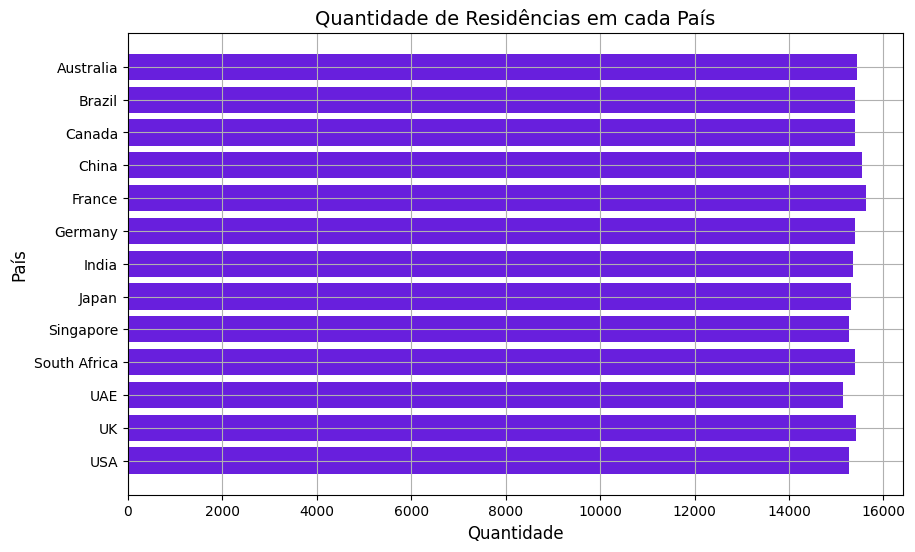

In [5]:
paises = df['country'].value_counts().sort_index(ascending=False) # Conta a frequência de cada país e ordena por nome do país

plt.figure(figsize=(10, 6)) # Define o tamanho da figura
plt.barh(paises.index, paises, color="#681FDD") # Cria um gráfico de barras horizontal
plt.title('Quantidade de Residências em cada País', fontsize=14) # Define o título do gráfico
plt.xlabel('Quantidade', fontsize=12) # Define o rótulo do eixo x
plt.ylabel('País', fontsize=12) # Define o rótulo do eixo y
plt.grid(True) # Exibe a grade no gráfico
plt.show()

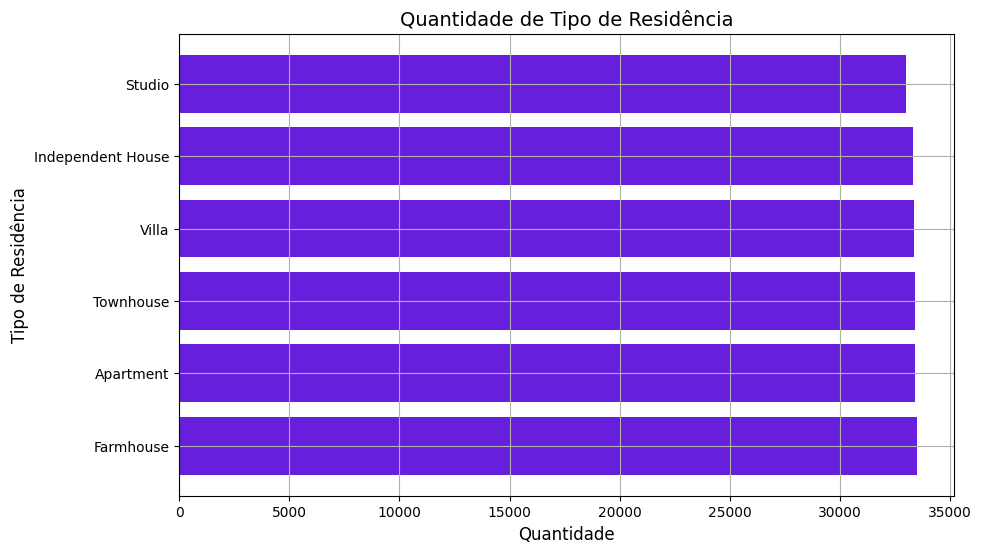

In [6]:
tipo_propriedade = df['property_type'].value_counts() # Conta a frequência de cada tipo de propriedade

plt.figure(figsize=(10, 6))
plt.barh(tipo_propriedade.index, tipo_propriedade, color="#681FDD")
plt.title('Quantidade de Tipo de Residência', fontsize=14)
plt.xlabel('Quantidade', fontsize=12)
plt.ylabel('Tipo de Residência', fontsize=12)
plt.grid(True)
plt.show()

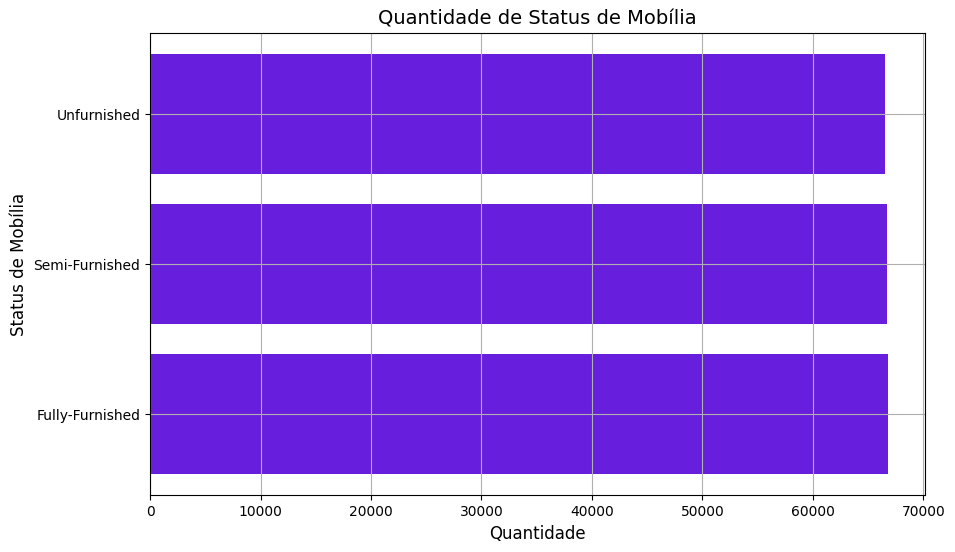

In [7]:
status_mobilia = df['furnishing_status'].value_counts() # Conta a frequência de cada status de mobília

plt.figure(figsize=(10, 6))
plt.barh(status_mobilia.index, status_mobilia, color="#681FDD")
plt.title('Quantidade de Status de Mobília', fontsize=14)
plt.xlabel('Quantidade', fontsize=12)
plt.ylabel('Status de Mobília', fontsize=12)
plt.grid(True)
plt.show()

Para garantir que as variáveis categóricas possuem apenas valores únicos, foram feitos gráficos para cada uma que contavam a quantidade que cada valor aparecia em sua determinada coluna. Com isso, certificou-se que não haviam valores escritos de forma incorreta ou valores iguais, porém escritos de maneira diferentes, o que significa que nenhuma correção para essas informações precisa ser feita.

Além disso, os gráficos permitiram que algumas informações fosse retiradas: os países, tipos de propriedades e status de mobílias presentes na base de dados possuem, essencialmente, a mesma quantidade de residências registradas no arquivo CSV desse projeto, ou seja, não existe nenhuma informação dessas categorias que se tem mais ou menos conhecimento. Contudo, no caso das cidades, percebe-se que existem muitas mais opções de locais onde a propriedade pode se encontrar, com muitos casos sendo mais prevalentes que outros, como Singapura, que contém 15.000 das residências da base, enquanto Mumbai e Pune possuem apenas cerca de 2.500

### Dados Estatísticos das Variáveis Quantitativas

In [8]:
df.describe() # Exibe estatísticas descritivas do DataFrame

,property_size_sqft,price,constructed_year,previous_owners,rooms,bathrooms,garage,garden,crime_cases_reported,legal_cases_on_property,customer_salary,loan_amount,loan_tenure_years,monthly_expenses,down_payment,emi_to_income_ratio,satisfaction_score,neighbourhood_rating,connectivity_score,decision
count,200000.000000,2.000000e+05,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,2.000000e+05,200000.000000,200000.000000,2.000000e+05,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000
mean,3195.633460,1.215365e+06,1991.487770,3.001370,4.513855,2.760030,0.499350,0.500215,1.229065,0.248920,46528.625830,7.597583e+05,19.986375,10559.693105,4.556068e+05,0.195387,5.498650,5.505240,5.495615,0.230340
std,1613.322287,8.236633e+05,18.494064,2.002198,2.295669,1.840959,0.500001,0.500001,1.185336,0.432388,27997.353766,5.489401e+05,7.081080,5427.241879,3.629865e+05,0.219689,2.875361,2.870945,2.870206,0.421052
min,400.000000,5.628800e+04,1960.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,2000.000000,2.350400e+04,10.000000,500.000000,8.966000e+03,0.000000,1.000000,1.000000,1.000000,0.000000
25%,1802.000000,5.659895e+05,1975.000000,1.000000,3.000000,1.000000,0.000000,0.000000,0.000000,0.000000,21450.000000,3.372802e+05,15.000000,5770.000000,1.849592e+05,0.070000,3.000000,3.000000,3.000000,0.000000
50%,3190.000000,1.023429e+06,1991.000000,3.000000,5.000000,2.000000,0.000000,1.000000,1.000000,0.000000,41465.000000,6.269325e+05,20.000000,10520.000000,3.561700e+05,0.130000,5.000000,5.000000,5.000000,0.000000
75%,4589.000000,1.725556e+06,2008.000000,5.000000,7.000000,4.000000,1.000000,1.000000,2.000000,0.000000,70805.000000,1.058416e+06,25.000000,15260.000000,6.257352e+05,0.240000,8.000000,8.000000,8.000000,0.000000
max,6000.000000,4.202732e+06,2023.000000,6.000000,8.000000,8.000000,1.000000,1.000000,10.000000,1.000000,100000.000000,3.520150e+06,30.000000,20000.000000,2.492723e+06,3.460000,10.000000,10.000000,10.000000,1.000000


A função "describe()" mostra os principais dados estatísticos das variáveis numéricas presentes no df: a quantidade, a média, o desvio padrão, os valores mínimo e máximo, o Primeiro Quartil,o Terceiro Quartil e a mediana. Com essas informações, é possível entender melhor a variação de cada variável, verificar se os valores estão de acordo com o esperado para aquele tipo de informação e ainda detectar a possível presença de "outliers", valores extremos que podem prejudicar o processamento dos modelos.

Analisando esses valores estatísticos, não foi possível notar nenhuma incoerência com as informações, como uma preço negativo ou um ano de construção futuro, portanto nenhuma correção precisa ser feita nesse aspecto. Contudo, existem algumas variáveis que apresentaram um comportamento que pode indicar a existência de "outliers": as colunas 'price', 'loan_amount' e 'down_payment' apontaram um valor mínimo significativamente menor do que o valor do Primeiro Quartil (25%) e, juntamente com o 'emi_to_income_ratio', um valor máximo significativamente maior do que o valor do Terceiro Quartil (50%). Normalmente, esse tipo de alta variação é um bom indicativo de que existem valores fora do padrão, possivelmente "outliers" que podem distorcer a visão da máquina em relação aos dados e gerar previsões incorretas, que sofreram enviesamento, porém é importante notar que em todas essas 4 variáveis citadas, a média e a mediana são bem próximas, o que é um sinal mais comum quando a distribuição é mais uniforme, sem valores muito extremos.

Para entender melhor esses casos, além de aprofundar na compreensão da base de maneira geral, a próxima etapa da EDA será uma análise mais específica e detalhada das colunas por meio de diversos gráficos, visando identificar quais informações aparentam ter mais relevância para a decisão de comprar ou não a residência, bem como entender a influência que as variáveis tem entre si.

## Análise dos Dados com Gráficos

### Histograma de Salário do Cliente

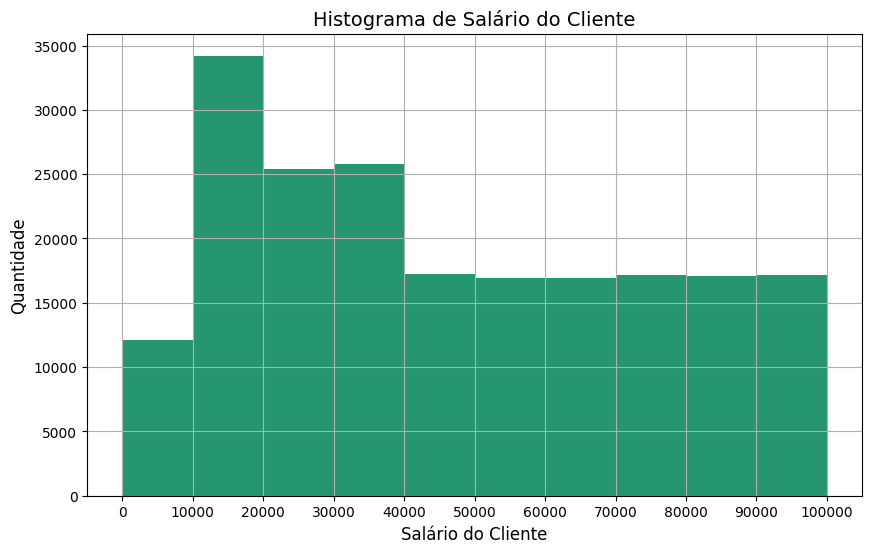

In [9]:
plt.figure(figsize=(10, 6))

bins = np.arange(0, max(df['customer_salary']) + 10000, 10000) # Define os bins para o histograma

plt.hist(x=df['customer_salary'], color="#269671", bins=bins) # Cria o histograma do salário do cliente
plt.title('Histograma de Salário do Cliente', fontsize=14) 
plt.xlabel('Salário do Cliente', fontsize=12)
plt.ylabel('Quantidade', fontsize=12)
plt.xticks(bins)
plt.grid(True)
plt.show()

O gráfico acima mostra como está distribuída a variação de valores da variável que representa o salário do cliente de 10.000 em 10.000. Através desse histograma, pode-se perceber que tem-se uma concentração maior de casos em que o indivíduo possuí uma salário entre 10.000 a 40.000, em maior quantidade principalmente entre 10.000 a 20.000, com quase 35.000 dos casos se encaixando nessa variação, enquanto aqueles com salário menor do que 10.000 compõe a menor quantidade dos casos registrados, um pouco mais de 10.000, enquanto aqueles que se encontram com um maior de 40.000 até 100.000 possuem basicamente a mesma quantidade (contando em um intervalo de 10.000), com cerca de 15.000 para cada "bin".

### Histograma de Despesa Mensal

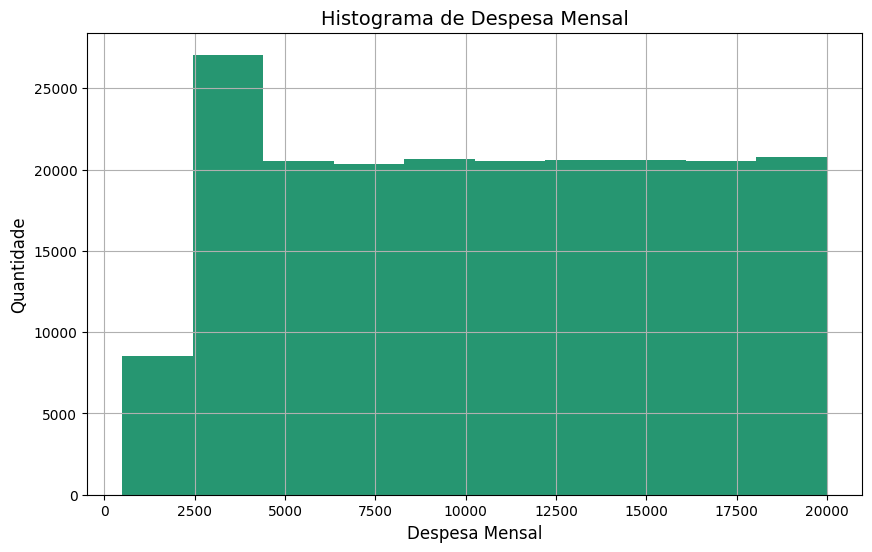

In [10]:
plt.figure(figsize=(10, 6))

plt.hist(x=df['monthly_expenses'], color="#269671") # Cria o histograma da despesa mensal
plt.title('Histograma de Despesa Mensal', fontsize=14)
plt.xlabel('Despesa Mensal', fontsize=12)
plt.ylabel('Quantidade', fontsize=12)
plt.grid(True)
plt.show()

Similar ao gráfico anterior, esse histograma mostra como os valores da despesa mensal dos clientes está distribuída na base de dados. Percebe-se que a concentração maior está entre cerca 2.500 e 4.500, com 25.000 dos casos possuindo uma despesa mensal entre esse intervalo, enquanto os casos abaixo de 2.500 de valor compõe a menor quantidade, com cerca de 8.500 dos casos. Com isso, os casos de despesa mensal maior de 4.500 até o valor máximo de 20.000, em um intervalo de 2.500, temos uma quantidade média dos casos, com um pouco mais de 20.000 de quantidade por "bin".

### Gráfico de Dispersão de Preço e Tamanho da Propriedade

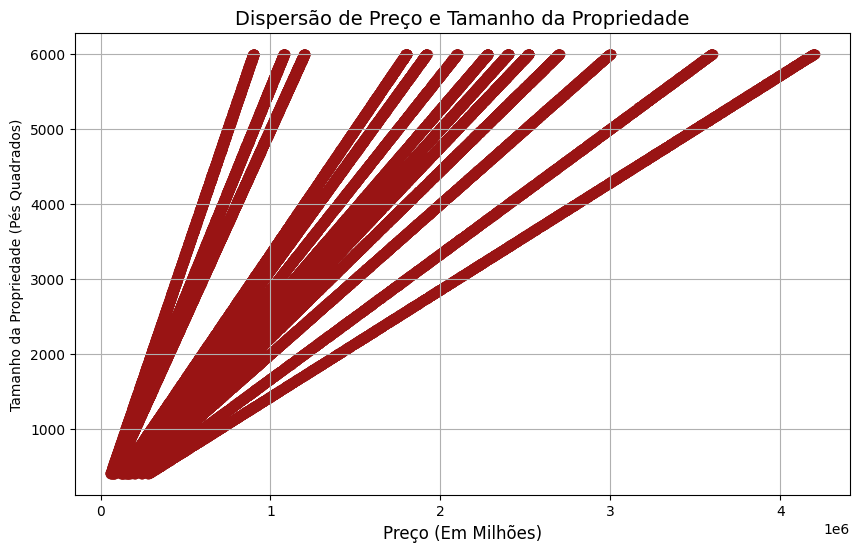

In [11]:
plt.figure(figsize=(10, 6)) 
plt.scatter(x=df['price'], y=df['property_size_sqft'], color="#991414", alpha=0.4) # Cria um gráfico de dispersão entre preço e tamanho da propriedade
plt.title('Dispersão de Preço e Tamanho da Propriedade', fontsize=14)
plt.xlabel('Preço (Em Milhões)', fontsize=12)
plt.ylabel('Tamanho da Propriedade (Pés Quadrados)')
plt.grid(True)
plt.show()

Para entender melhor o comportamento das variáveis presentes na base de dados, é importante verificar como elas interagem entre si. O gráfico de dispersão acima busca evidenciar a distribuição dos casos registrados de acordo com o preço e tamanho dos imóveis, duas informações que comumente possuem peso considerável na decisão de compra de uma propriedade, já que um local muito pequeno com preço extremamente alto gera desinteresse pelo negativo custo benefício, com o esperado sendo que as casas maiores sejam sempre as mais caras.

No caso do df desse projeto, contudo, percebe-se um comportamento diferente da relação entre preços e tamanhos das residências. Como mostrado no gráfico, é possível notar que a dispersão chega a formar diversas "linhas", com ângulos e inclinações diferentes, o que indica que existem "grupos" entre os imóveis registrados que possuem características em comum, que não são o preço ou tamanho. Em outras palavras, mesmo que existam casos de residências com preço (ou tamanho) próximo, o tamanho (ou preço) de cada um pode ser bem distinto, pois fatores como localização do imóvel (país, cidade, bairro), a presença de garagem e jardim e a quantidade de quartos e banheiros, podem ter um impacto significativo nessa variável. Dessa forma, a relação entre o preço e o tamanho é mais complexa e depende de outras informações para ser compreendida.

Ainda assim, entre esses grupos, existem algumas semelhanças em comum que permitem que algumas conclusões sejam tiradas:

* Uma propriedade que está entre as menores de tamanho, menor que 2.000 pés quadrados, também se encontra entre as propriedades mais baratas, custando, geralmente, menos que 1.000.000 (ou pouco mais que isso).

* As residências entre os maiores preços, com 3.000.000 ou mais, se encontram também nos imóveis de maior porte, todas acima de 4.000 e a maioria acima de 5.000 pés quadrados. Contudo, não são todas as maiores propriedades que se encontram com maior custo.

### Gráfico de Dispersão de Valor de Empréstimo e Pagamento Adiantado

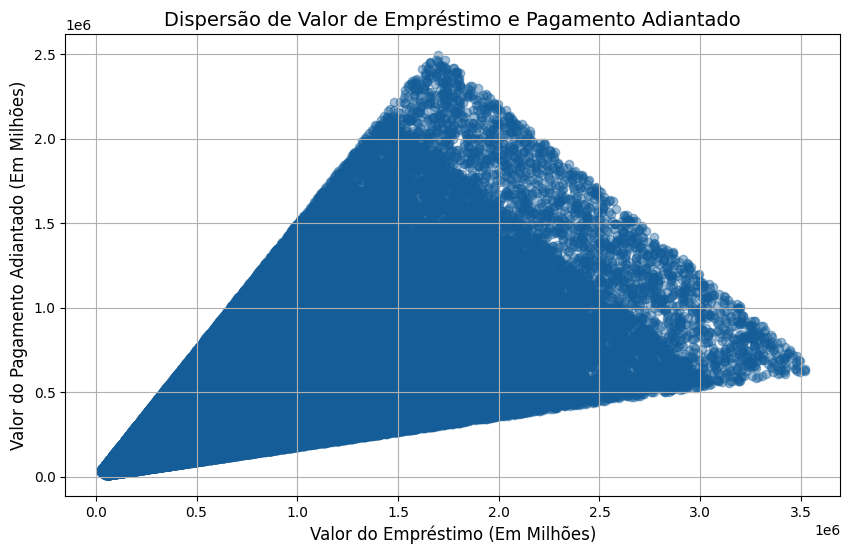

In [12]:
plt.figure(figsize=(10, 6))
plt.scatter(x=df['loan_amount'], y=df['down_payment'], color="#145D99", alpha=0.4) # Cria um gráfico de dispersão entre valor do empréstimo e pagamento adiantado
plt.title('Dispersão de Valor de Empréstimo e Pagamento Adiantado', fontsize=14)
plt.xlabel('Valor do Empréstimo (Em Milhões)', fontsize=12)
plt.ylabel('Valor do Pagamento Adiantado (Em Milhões)', fontsize=12)
plt.grid(True)
plt.show()

Por se tratarem de informações relacionadas com decisões monetárias feitas pelos clientes, analisar a relação entre as variáveis do valor do pagamento adiantado e do empréstimo retirado se torna crucial para entender melhor o comportamento dos possíveis compradores. Consequentemente, é possível entender melhor os critérios e padrões visíveis tanto nos que adquirem a residência quanto naqueles que não, possibilitando que atitudes prévias possam ser tomadas para garantir um resultado satisfatório, além de boa compreensão do processo que o modelo de previsão realiza.

Vendo como os dados estão distribuídos no gráfico acima, pode se notar que formam uma espécie de triângulo, com uma base estendida ao longo de todo o eixo X (Empréstimo), com uma das linhas que se eleva até o máximo do eixo Y (Pagamento Adiantado) e se estende do começo ao meio do eixo X e a outra que parte do topo do eixo Y e cai até um valor mais baixo (perto de 0.5), a partir da metade até o valor máximo do eixo X. Todos os dados se encontram nessa área, o que indica que não existente "outliers" aparentes nessa relação, mas revela que seu padrão não é simples e linear, indicando que existem perfis de compras diferentes na base.

Da mesma maneira que a análise de preço e tamanho mostrou "grupos" diferentes para as residências, a correlação de empréstimo e pagamento adiantado revelou que existem distintas maneiras que os compradores lidam com as questões monetárias, que são influenciadas por fatores como: salário, despesa mensal, localização e preço da residência. Ainda assim existem informações verdadeiras para todos os clientes que podem ser retiradas desse gráfico:

* Os clientes que realizaram os menores valores de empréstimo (menos que 0.5) são também aqueles com menor pagamento adiantado (menos que 0.5). Isso pode indicar um grupo com melhor situação financeira, mas com menor interesse ou urgência em adquirir a residência ou com menor custos de reformas e garantias do local. 

* Os clientes com maior pagamento adiantado (acima de 2.0) realizam empréstimos mais medianos (entre 1.3 a 2.2). Há, então, um possível grupo de clientes com maiores custos a cobrirem ou interesse na residência e com condições monetárias boas ou acima da média.

* Os clientes com maiores empréstimos (acima de 3.0) fizeram pagamentos adiantados relativamente menores do que esse outra variável (entre 0.5 a 1.2). Esse perfil de comprador possivelmente realizou o empréstimo por um outro motivo mais relevante do que o pagamento adiantado, como um alto custo total da residência ou das despesas mensais. Contudo, mesmo que o pagamento adiantado seja bem menor, o valor alto do empréstimo indica que o interesse na residência é forte.

* Os casos com os menores pagamentos adiantados (menos que 0.5) podem ter realizado empréstimos tanto baixos quanto altos, mas tendem a ser menores.

### Gráficos de Dispersão de Pagamento Adiantado e Valor do Empréstimo com Preço e Tamanho

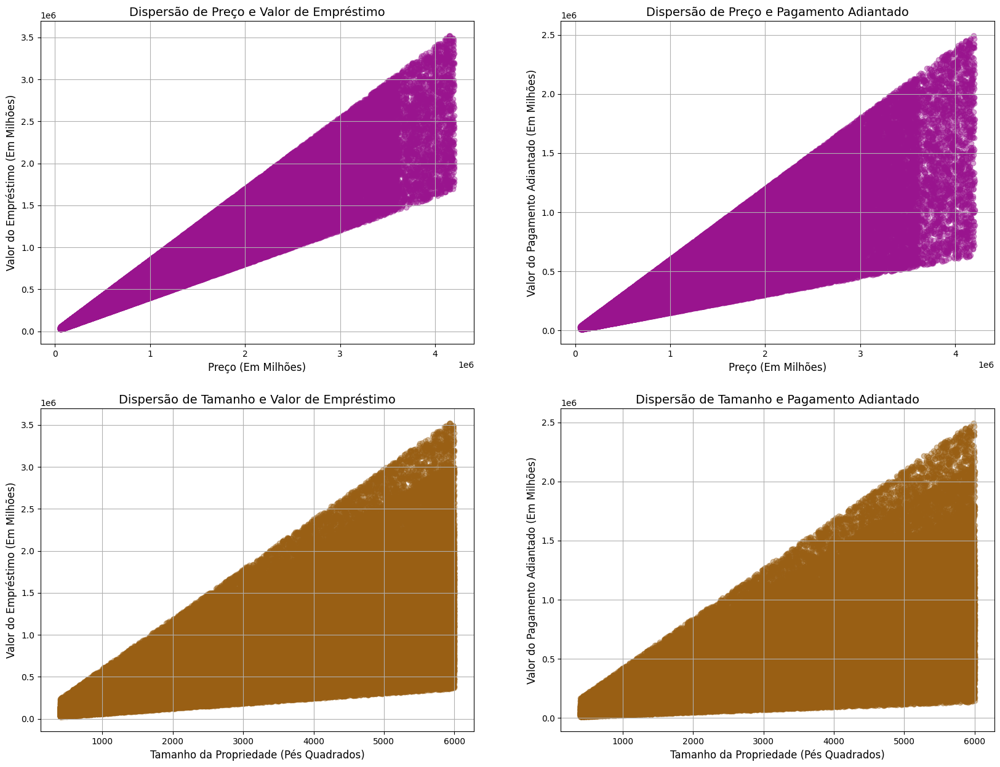

In [13]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 15)) # Cria uma grade de subplots 2x2 para múltiplos gráficos de dispersão

ax1.scatter(x=df['price'], y=df['loan_amount'], color="#99148E", alpha=0.4) # Gráfico de dispersão entre preço e valor do empréstimo
ax1.set_title('Dispersão de Preço e Valor de Empréstimo', fontsize=14) # Define o título do gráfico
ax1.set_xlabel('Preço (Em Milhões)', fontsize=12) # Define o rótulo do eixo x
ax1.set_ylabel('Valor do Empréstimo (Em Milhões)', fontsize=12) # Define o rótulo do eixo y
ax1.grid(True) # Adiciona grade ao gráfico

ax2.scatter(x=df['price'], y=df['down_payment'], color="#99148E", alpha=0.4) # Gráfico de dispersão entre preço e pagamento adiantado
ax2.set_title('Dispersão de Preço e Pagamento Adiantado', fontsize=14)
ax2.set_xlabel('Preço (Em Milhões)', fontsize=12)
ax2.set_ylabel('Valor do Pagamento Adiantado (Em Milhões)', fontsize=12)
ax2.grid(True)

ax3.scatter(x=df['property_size_sqft'], y=df['loan_amount'], color="#995F14", alpha=0.4) # Gráfico de dispersão entre tamanho da propriedade e valor do empréstimo
ax3.set_title('Dispersão de Tamanho e Valor de Empréstimo', fontsize=14)
ax3.set_xlabel('Tamanho da Propriedade (Pés Quadrados)', fontsize=12)
ax3.set_ylabel('Valor do Empréstimo (Em Milhões)', fontsize=12)
ax3.grid(True)

ax4.scatter(x=df['property_size_sqft'], y=df['down_payment'], color="#995F14", alpha=0.4) # Gráfico de dispersão entre tamanho da propriedade e pagamento adiantado
ax4.set_title('Dispersão de Tamanho e Pagamento Adiantado', fontsize=14)
ax4.set_xlabel('Tamanho da Propriedade (Pés Quadrados)', fontsize=12)
ax4.set_ylabel('Valor do Pagamento Adiantado (Em Milhões)', fontsize=12)
ax4.grid(True)

plt.show()

Os 4 gráficos de dispersão acima estão sendo apresentados coletivamente, pois se tratam de correlações entre as variáveis de preço e tamanho com as de pagamento adiantado e empréstimo, que possuem características semelhantes na maneira como estão distribuídos e fornecem informações parecidas para a análise de dados. 

Os gráficos da primeira linha mostram como a variável preço se comporta de acordo com o valor de empréstimo e pagamento adiantado, respectivamente, e é possível perceber que essa variação é essencialmente igual: existe um triângulo formado, que começa a partir do ponto 0 (direita inferior) de ambos os eixos e cresce diagonalmente até o ponto máximo (esquerda superior) de ambos também, com outra das linhas indo do ponto 0 até o máximo de X e o meio de Y e a outra sendo uma reta que permanece do máximo de X e vai do topo de Y até o seu meio (ou um pouco mais que isso, no caso do pagamento adiantado). O que é possível perceber a partir dessas noções é que quanto menor o preço, menor será o empréstimo ou o pagamento adiantado, e, por outro lado, quanto mais caro for o imóvel, mais distinto podem ser os valores dessa variáveis, porém sempre se elevando, ainda que de maneira menos específica e padronizada.

A segunda linha de gráficos mostra a correlação do tamanho do imóvel com o empréstimo e pagamento adiantado, respectivamente. A variação nesses casos também possuem um formato triangular, porém de maneira mais ampla, com uma inclinação diagonal partindo do ponto 0 dos eixos e indo ao ponto máximo, com uma das linhas se estendendo ao longo de todo eixo X, nos valores mais baixos do eixo Y, e outra no valor máximo de X e se estende ao longo de todo Y. Com isso, é possível afirmar que quanto maior o tamanho da propriedade, mais variado é o empréstimo/pagamento adiantado, e que empréstimos/pagamento adiantados menores podem indicar residências de uma gama de tamanhos de propriedades.

### BoxPlot de Score de Satisfação por Decisão

In [14]:
fig = px.box(df, x='decision', y='satisfaction_score') # Cria um BoxPlot do score de satisfação por decisão de compra

fig.update_layout( # Atualiza o layout do gráfico
    title = {'text': 'BoxPlot de Score de Satisfação por Decisão', 'font': {'size': 22}}, # Título do gráfico
    yaxis_title = {'text': 'Score de Satisfação','font': {'size': 18}}, # Rótulo do eixo y
    xaxis_title = {'text': 'Decisão', 'font': {'size': 18}}, # Rótulo do eixo x
    width = 1000, # Largura do gráfico
    height= 500 # Altura do gráfico
)

fig.update_xaxes(
    tickvals=[0, 1], # Define os valores dos ticks no eixo x
    ticktext=['Não', 'Sim'] # Define os textos dos ticks no eixo x
)

fig.show() # Exibe o gráfico interativo

Os BoxPlots mostram a distribuição dos valores do "score" de satisfação do cliente de acordo com a decisão negativa e positiva de compra da residência, a variável alvo do projeto. Analisando o BoxPlot para os casos em que não houveram compras, nota-se que a satisfação com o atendimento recebido vario de 1 a 10, ou seja, quando o imóvel não foi vendido, tiveram tanto situações em que o cliente se sentiu completamente insatisfeito com o atendimento quanto situações em que se saiu totalmente satisfeito, mas com uma maior concentração de casos em que o "score" foi mais baixo, entre 2 e 6. Por outro lado, quando a venda da propriedade foi bem sucedida, essa variável teve uma variação menor e apenas entre notas maiores, entre 7 a 10, concentrando-se principalmente entre 8 e 10.

Com isso, um insight valioso pode ser retirado através desse gráfico: se o cliente se sentir pouco satisfeito com o atendimento fornecido, ele provavelmente não irá comprar a residência, enquanto se sua nota de satisfação for mais elevada, há uma chance muito maior de que a venda seja completada. Com isso, essa variável se torna extremamente importante para a variável alvo e, consequentemente, terá grande impacto nos modelos.

### BoxPlot de Crimes Reportados por Decisão

In [15]:
fig = px.box(df, x='decision', y='crime_cases_reported') # Cria um BoxPlot de crimes reportados por decisão de compra

fig.update_layout(
    title = {'text': 'BoxPlot de Crimes Reportados por Decisão', 'font': {'size': 22}},
    yaxis_title = {'text': 'Crimes Reportados','font': {'size': 18}},
    xaxis_title = {'text': 'Decisão', 'font': {'size': 18}},
    width = 1000,
    height= 500
)

fig.update_xaxes(
    tickvals=[0, 1],
    ticktext=['Não', 'Sim']
)

fig.show()

Semelhante com o último gráfico, os BoxPlots acima mostram a distribuição de quantidade de crimes reportados perto da residência por decisão de compra. Pode-se perceber que a maior concentração dos casos tanto para quando a compra não foi feita quanto para quando foi se encontra nos valores mais baixos, em que o "Não" está entre 0 a 2 e, o "Sim", no 0 a 1. Contudo, percebe-se uma diferença distinta na variação total dos 2: enquanto o BoxPlot de venda realizada tem uma quantidade de crimes reportados que vai de 0 a 2, o de venda não completada varia do 0 até o 5 de crimes reportados, com alguns valores fora do padrão indo de 6 a 10 crimes reportados.

Isso mostra que, apesar da concentração para ambos os cenários ser essencialmente a mesma, quando há mais crimes reportados perto da propriedade, menos provável é de que a compra seja feita. Com isso, pode-se dizer que, para os clientes da base, a questão da segurança tem uma boa influência sobre a escolha de compra de uma propriedade.

### Gráfico de Quantidade de Propriedades Envolvidas em Casos Jurídicos por Decisão

In [16]:
fig = px.histogram(df, x='decision', color='legal_cases_on_property', barmode='stack') # Cria um histograma empilhado de decisões por casos jurídicos na propriedade

fig.update_layout(    
    title = {'text': 'Quantidade de Propriedades Envolvidas em Casos Jurídicos por Decisão', 'font': {'size': 16}},
    yaxis_title = {'text': 'Quantidade', 'font': {'size': 14}},
    xaxis_title = {'text': 'Decisão', 'font': {'size': 14}},
    legend_title= 'Casos Jurídicos',
    width = 700,
    height= 500,
    bargap=0.2 # Espaçamento entre as barras
)

fig.update_xaxes(
    tickvals=[0, 1],
    ticktext=['Não', 'Sim']
)

fig.show()

O gráfico acima mostra a quantidade de propriedades envolvidas em algum caso jurídico por decisão de compra, em que os casos em que não há situações desse tipo está da cor azul ("0"), enquanto os que possuem está da cor vermelha ("1"). O primeiro ponto que se pode perceber é que a base de dados conta com cerca de 50.000 residências envolvidas em alguma disputa legal e o triplo disso (150.000) de propriedades sem nenhum problema judicial. Ressalta-se, no entanto, que todos os imóveis que se encontram em "1" não foram vendidos para os possíveis clientes, com 104.000 dos outros casos sendo de residências com "0", enquanto a coluna "Sim" possui apenas propriedades sem nenhum caso jurídico, cerca de 46.000.

Isso permite que mais uma conclusão possa ser tirada: residências envolvidas em alguma questão judicial são muito mais prováveis de não serem compradas. Isso se deve possivelmente aos possíveis desafios que comprar um imóvel nessa situação pode proporcionar, tornando-os menos atrativos aos compradores, mas revelando uma nova variável que será eficiente para as previsões dos modelos.

## Outliers

### Variáveis com Possíveis Outliers

In [17]:
colunas = { # Dicionário para armazenar as colunas de interesse
    'Preço': df['price'],
    'Empréstimo': df['loan_amount'],
    'Pagamento Adiantado': df['down_payment']    
}

df_colunas = pd.DataFrame(colunas) # Cria um DataFrame a partir do dicionário

df_colunas = pd.melt(df_colunas, var_name='Colunas', value_name='Valores') # Transforma o DataFrame para formato longo, facilitando a criação do apenas 1 BoxPlot com múltiplas variáveis

fig = px.box(df_colunas, x='Colunas', y='Valores', color='Colunas') # Cria o BoxPlot das variáveis de interesse

fig.update_layout(
    title = {'text': 'BoxPlot de Variáveis em Milhões(M)', 'font': {'size': 22}},
    yaxis_title = {'font': {'size': 18}},
    xaxis_title = {'text': 'Variáveis', 'font': {'size': 18}},
    legend_title = {'text': 'Variáveis', 'font': {'size': 18}},
    width = 1000,
    height= 500
)

fig.show()

Como explicado na etapa da análise inicial de informações estatísticas sobre as variáveis, algumas variáveis apresentaram uma possível existência de "outliers", isso é, valores extremos que não se encaixam com o padrão da distribuição daquela variável específica. A identificação desses casos é importante, pois esses valores podem representar dados inseridos de maneira incorreta, seja, por exemplo, por erro de digitação ou colocados na coluna errada da base, o que pode gerar confusão na etapa de previsão dos modelos e causar resultado enviesados e errôneos.

Para entender melhor como esses "outliers" estão se comportando na base de dados, o uso do gráfico de BoxPlot permite uma melhor visualização e identificação desses valores extremos. Vendo que as variáveis de preço, empréstimo e pagamento adiantado estavam todas variando na casa dos milhões, seus BoxPlots foram feitos em uma mesma imagem, buscando para manter um ambiente de código mais organizado e permitir comparações mais diretas entre eles. Além disso, foi possível notar que nessas 3 variáveis, o comportamento dos "outliers" é idêntica: eles se encontram todos acima do limite superior do BoxPlot, indicando números mais altos do que é comum para aquela informação, havendo um diversidade de valores presentes entre eles que partem de valores mais próximos do limite superior, mais próximos de estarem no padrão, e se estendem até terem uma diferença significativamente maior, mas não muito discrepante. Consequentemente, os "outliers" dessas variáveis, por terem valores muito próximos entre si, acabam formando um espécie de "linha reta" a partir do limite superior do gráfico.

Apesar dessa quantidade considerável de dados fora do padrão nessas variáveis, é incorreto afirmar que esses valores são incorretos ou irrealistas, já que os tipos de informações que eles representam justifica essa variação mais extrema. O preço de um imóvel pode assumir qualquer tipo de valor e depende das características da propriedade para ser definido, enquanto o empréstimo e pagamento adiantado vai depender dos próprios clientes e do seus tipos de perfis de compra, que podem ser mais únicos ou genéricos, o que significa que, dentro dos casos apresentados pela base de dados, a existência de algumas exceções ao que é mais predominante não só faz sentido, como também está de acordo com o esperado.

In [18]:
fig = px.box(df, y='emi_to_income_ratio') # Cria um BoxPlot da proporção de "Equated Monthly Instalment" (EMI) para renda

fig.update_layout(
    title = {'text': 'BoxPlot de Proporção de "Equated Monthly Instalment" (EMI) para Renda', 'font': {'size': 16}},
    yaxis_title = {'text': 'Valores', 'font': {'size': 14}},
    xaxis_title = {'text': 'Proporção de EMI para Renda', 'font': {'size': 14}},
    width = 700,
    height= 500
)

fig.show()

A quarta variável que apresentou "outliers" foi a de proporção de EMI para renda. Diferentemente das anteriores, o comportamento dos valores extremos nessa variável é bem mais intenso, já que, como pode ser observado no gráfico acima, o BoxPlot está bem mais achatado na área onde a maior concentração de dados está, com os outliers presentes acima do limite superior e variando desde de números próximo a esse limite até valores muito mais elevados e distantes de se encaixarem no que é esperado.

Essa coluna do df é uma informação que é definida por uma fórmula que divide a Parcela Mensal Estimada (EMI) pela renda mensal. O EMI, por sua vez, é o valor fixo que o cliente deve pagar  todos os meses até que o empréstimo seja totalmente pago e é definido por instituições financeiras de acordo com as diversas decisões que o comprador toma, como valor do pagamento adiantado, valor do empréstimo e tempo em que o mesmo deve ser pago. Dessa forma, por causa de existência de diversas estratégias de compra únicas presentes na base de dados, os valores da porcentagem da renda destinada ao pagamento do empréstimo acaba tendo alta variação e uma certa imprevisibilidade, explicando a presença de tantos "outliers".

### Verificação da Quantidade de Outliers

In [19]:
def pegar_outliers(df, variavel): # Função para identificar outliers usando o método do IQR
    Q3 = df[variavel].quantile(0.75) # Cálculo do terceiro quartil
    Q1 = df[variavel].quantile(0.25) # Cálculo do primeiro quartil
    IQR = Q3 - Q1 # Cálculo do intervalo interquartil
 
    limite_inferior = Q1 - 1.5 * IQR # Cálculo do limite inferior para outliers
    limite_superior = Q3 + 1.5 * IQR # Cálculo do limite superior para outliers

    outliers = df[(df[variavel] < limite_inferior) | (df[variavel] > limite_superior)] # Filtra os outliers com base nos limites calculados
    return outliers # Retorna o DataFrame contendo apenas os outliers

In [20]:
variaveis_outliers = df[['price', 'loan_amount', 'down_payment', 'emi_to_income_ratio']] # Seleciona as variáveis com presença de outliers

for variavel in variaveis_outliers: # Itera sobre cada variável para identificar e exibir os outliers
    outliers = pegar_outliers(df, variavel) # Chama a função para obter os outliers da variável atual
    quantidade = len(outliers) # Conta a quantidade de outliers encontrados
    porcentagem = (quantidade / len(df)) * 100 # Calcula a porcentagem de outliers em relação ao total de registros
    print(f"""
Variável: {variavel} 
Qtde de Outliers: {quantidade}
Porcentagem de Outliers: {porcentagem:.2f}%""")
# O print mostra a variável, quantidade e porcentagem de outliers encontrados nas variáveis selecionadas para analisar qual a melhor abordagem para tratamento


Variável: price 
Qtde de Outliers: 3374
Porcentagem de Outliers: 1.69%

Variável: loan_amount 
Qtde de Outliers: 4920
Porcentagem de Outliers: 2.46%

Variável: down_payment 
Qtde de Outliers: 7153
Porcentagem de Outliers: 3.58%

Variável: emi_to_income_ratio 
Qtde de Outliers: 15371
Porcentagem de Outliers: 7.69%


Com o objetivo de entender melhor a quantidade total de "outliers" presentes nas 4 variáveis analisadas anteriormente e a porcentagem total que eles representam em toda a base, foi criada uma função para coletar apenas os "outliers" utilizando o Intervalo Interquartil (IQR), medida comumente usada para descobrir esse valores extremos de maneira eficaz. Através disso, foi possível perceber que, apesar de existirem diversos casos com valores extremos, se comparados com o tamanho do df total de 200.000 linhas, a porcentagem é pequena para as 3 primeiras variáveis analisadas, sendo um pouco maior para a última.

Essas conclusões proporcionam uma melhor noção sobre como os "outliers" podem ser tratados. Considerando que os valores extremos de preço, empréstimo e pagamento adiantado são variações esperadas pelo tipo de informação que retratam, excluí-las seria incorreto e prejudicaria a capacidade do modelo ao se deparar com esses tipos de dados. Além disso, vendo que a quantidade de "outliers" presentes nessas 3 variáveis representa uma parte pequena do total, um enviesamento do modelo é improvável ou bem insignificante a ponto de que esses valores não precisam passar por nenhum tratamento específico.

Vendo que retirar todos os casos em que os 'emi_to_income_ratio' significaria perder uma quantidade considerável de informações relevantes para o modelo, o enviesando, diminui bastante a variação da variável, dificultando e limitando o entendimento da influência desse dado na decisão de compra, além de ser uma variável em que tais casos fora do padrão são esperados por sua imprevisibilidade, a melhor solução para tratar os valores extremos dessa situação é suavizar o seu impacto, sem excluir ou mudar os valores, mas os transformar sem mudar seu significado.

### Tratamento de Outliers

In [21]:
df['emi_to_income_ratio'] = np.log1p(df['emi_to_income_ratio']) # Aplica a transformação logarítmica na variável 'emi_to_income_ratio' para reduzir o impacto dos outliers
df = df.rename(columns={'emi_to_income_ratio': 'emi_to_income_ratio_log' }) # Renomeia a coluna para refletir a transformação aplicada

Já que as outras colunas não precisam ser tratadas, os únicos "outliers" a serem resolvidos são os da variável 'emi_to_income_ratio'. Como estabelecido na explicação anterior, a melhor forma de lidar com eles seria suavizar seu impacto nas previsões para que seja o menor possível, e isso pode ser alcançado através da transformação logarítmica. Esse método consiste em substituir os valores pelo seu logaritmo, alterando a escala em que os dados estão dispostos, o que reduz a sua assimetria, comprime valores altos, aumenta o intervalo entre valores pequenos e torna a distribuição mais simétrica e normal. 

A forma como os dados estavam dispersos no BoxPlot dessa variável evidenciaram como essa distribuição era irregular, com muitos valores extremos, próximos e distantes da concentração principal das informações. Para cenário como esses, a transformação logarítmica é especialmente eficaz, contribuindo para um processamento mais eficiente e um melhor desempenho do modelo.

## Pré-Processamento

### Codificação de Variáveis Categóricas

In [22]:
ordem_furnishing_status = {'Unfurnished': 0, 'Semi-Furnished': 1, 'Fully-Furnished': 2} # Dicionário para mapear o status de mobília para valores numéricos

df['furnishing_status'] = df['furnishing_status'].map(ordem_furnishing_status) # Mapeia os valores de status de mobília para valores numéricos

df = df.rename({'furnishing_status': 'furnishing_status_encoded'}, axis=1) # Renomeia a coluna para indicar que foi codificada

df_encoded = df.copy() # Cria uma cópia do DataFrame para codificação

df_encoded = pd.get_dummies(df_encoded, columns=['country'], prefix=['country'], drop_first=True) # Aplica One-Hot Encoding na coluna 'country', removendo a primeira categoria para evitar multicolinearidade
df_encoded = pd.get_dummies(df_encoded, columns=['city'], prefix=['city'], drop_first=True) # Aplica One-Hot Encoding na coluna 'city', removendo a primeira categoria para evitar multicolinearidade
df_encoded = pd.get_dummies(df_encoded, columns=['property_type'], prefix=['property_type'], drop_first=True) # Aplica One-Hot Encoding na coluna 'property_type', removendo a primeira categoria para evitar multicolinearidade

for column in df_encoded.columns:
    if df_encoded[column].dtype == 'bool': # Verifica se a coluna é do tipo booleano
        df_encoded[column] = df_encoded[column].astype(int) # Converte a coluna booleana para inteiro

Após a Análise Exploratória dos Dados, a próxima etapa do projeto de ciência de dados é o pré-processamento dos dados. É aqui que alterações são feitas às informações da base para que essa esteja dentro dos parâmetros adequados para o processamento eficiente dos modelos e suas previsões resultantes.

Um fator muito importante dos modelos de "Machine Learning" é que os únicos tipos de dados que conseguem compreender são os quantitativos, ou seja, em valores numéricos. Isso significa que, para as variáveis qualitativas ou categóricas, é necessário realizar a codificação de seus valores, que nada mais consiste em substituir as "strings" escritas por números correspondentes. Foram utilizados 2 métodos diferentes para aplicação dessa etapa:

* **"Label Encoding"**: Essa primeira ferramente é tipicamente usada para as variáveis categóricas com apenas 2 valores possíveis, como gênero, ou ordinais, isso é, que seguem uma hierarquia, como por exemplo grau de escolaridade ou nível de score de crédito. Das 4 variáveis qualitativas presentes, apenas a 'furnishing_status' se encaixa em uma dessas duas possibilidades, seguindo uma ordem de quantidade de mobília, em que a ausência de mobília vira 0, propriedades semi-mobiliadas recebem 1 e residências totalmente mobiliadas são representadas por 2.

* **"One-Hot Encoding"**: Para as variáveis 'country', 'city' e 'property_type', que possuem diversos valores presentes em cada uma sem que haja um hierarquia estipulada, foi utilizado o "One-Hot Encoding". Esse método consiste em criar novas colunas binárias no df a partir de cada categoria presente nessas variáveis e é utilizado para casos assim, pois possibilita que essa variável categórica ainda seja levada em consideração no processamento ao invés de ser excluída totalmente e, se o método anterior fosse aplicado, uma ordem inexistente seria criada e imposta sobre a variável, o que poderia resultar em situações de confusão durante o processamento do modelo, além de previsões incorretas por assumir uma hierarquia fictícia. Dessa forma, residências, por exemplo, encontradas no país('country') Brasil, na cidade('city') de São Paulo e que são apartamentos('property_type') receberiam os valores de 1 nas colunas 'country_Brazil', 'city_SaoPaulo' e 'property_type_Apartment', mas 0 nas outras colunas criadas por esse método, como 'country_Japan' ou 'property_type_Farmhouse'. 

É importante ressaltar que, devido ao uso desse último método, a quantidade de colunas presentes no df aumentou consideravelmente, visto que foi aplicado em 3 variáveis que possuíam um grande leque de respostas possíveis (principalmente a de cidade, com 40). Normalmente, seria preferível evitar esse acréscimo exagerado, já que modelos que recebem mais variáveis diferentes tendem a ter um processamento mais lento e gerar conflito por um excesso de informações, mas por se tratarem de dados que podem evidenciar melhor as relações entre as outras características presentes, tanto dos imóveis quanto dos clientes, essa foi a rota escolhida.

### Gráfico de Matriz de Correlação

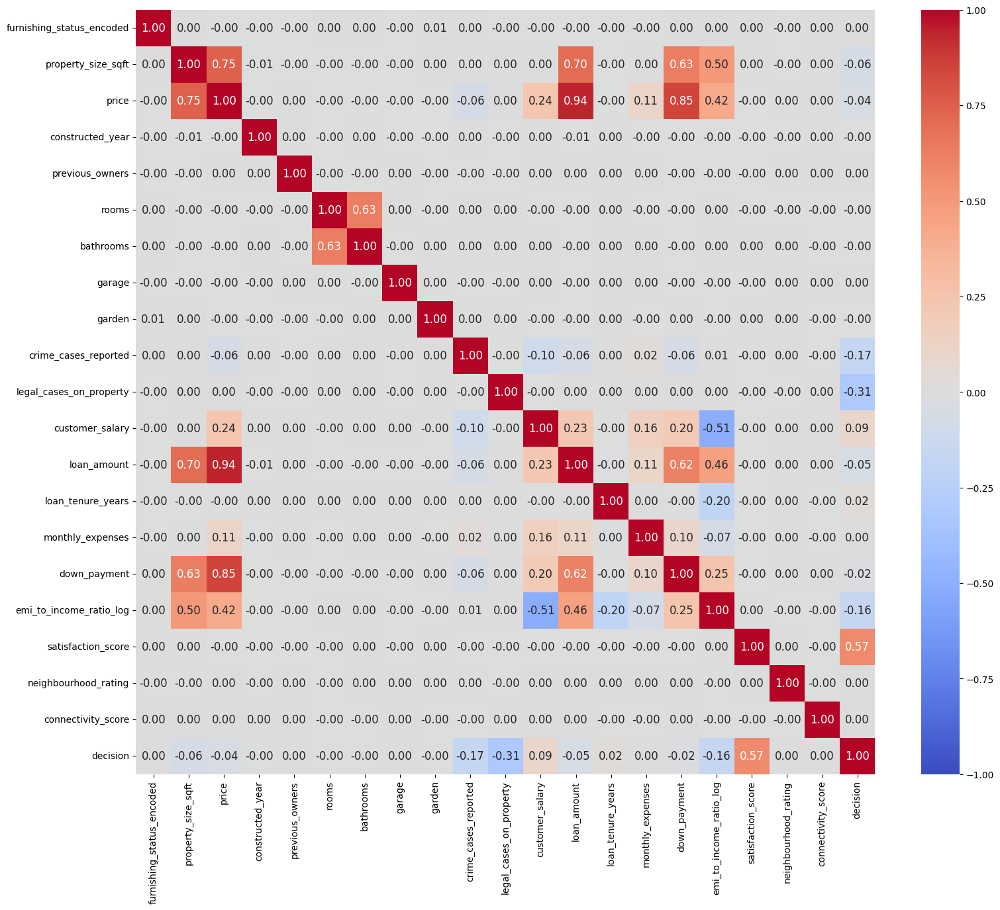

In [23]:
matriz_correlacao = df.drop(['country', 'city', 'property_type'], axis=1).corr() # Calcula a matriz de correlação, excluindo colunas categóricas

plt.figure(figsize=(18, 15))
sns.heatmap(data=matriz_correlacao, vmin= -1, cmap='coolwarm', fmt='.2f', annot=True, annot_kws={'size': 12}) # Cria um mapa de calor da matriz de correlação
plt.show()

Após a transformação das variáveis categóricas em numéricas, é importante quantificar a correlação das informações entre si com o intuito de descobrir mais detalhadamente quais as colunas do df possuem algum significado real e podem ter impacto no processamento dos modelos. Para isso, foi criado um gráfico de calor de matriz de correlação, permitindo entender em qual cenário cada uma das relações existentes se encontra:

* **Correlação Forte e Positiva**: São as correlações em que, quando uma variável eleva ou declinam, a outra tende a aumentar ou cair também. Quanto mais próximo de 1, mais forte e positiva é a correlação e mais avermelhado será o quadrado que a representa.

* **Correlação Forte e Negativa**: São as correlações em que, quando uma variável aumenta de valor, a tendência da outra é de abaixar, e vice versa. Aqui, quanto mais próximo de -1, mais forte e negativa é a correlação e mais azulado será o seu quadrado.

* **Correlação Neutra ou Fraca**: Nesses casos, o valor de uma variável subir ou diminuir não indica nenhuma tendência no valor da outra, isso é, não há relação direta. Quanto mais próximo de 0 é a correlação, mais fraca ou neutra ela é e mais cinza será seu quadrado.

Geralmente, os modelos de aprendizado analisam com mais importância as variáveis com correlações que se encaixam em alguma das duas primeiras categorias, já que os padrões para aquelas que se encontram na última seriam praticamente inexistente. Analisando o gráfico acima, é possível perceber que a base de dados possuem, predominantemente, variáveis de correlação fraca, com poucas apresentando algum tipo de significância, então, para evitar o excesso de informações desnecessárias que não contribuiriam para as previsões, tornariam o processamento dos modelos mais lentos e possivelmente prejudicariam os resultados finais, foi decidido retirar todas as variáveis independentes que não apresentaram nenhuma correlação forte ou que tiveram apenas uma relação valiosa com outra variável independente (para evitar problemas de multicolinearidade).

*Observação*: As variáveis desse gráfico são apenas aquelas que não foram passadas pelo "One-Hot Encoding". Por esse processo ter aumentado drasticamente a quantidade de variáveis do df, tornando uma coluna em várias, foi necessário separar essas para que a visualização do gráfico completo não fosse comprometida. Ao invés disso, será calculada a correlação dos "dummies" com apenas com a variável alvo, permitindo que essas informações ainda possam ser analisadas com o objetivo final em mente, ainda que de forma mais simples.

In [24]:
cidades = [] # Lista para armazenar os nomes das colunas de cidades
paises = [] # Lista para armazenar os nomes das colunas de países
tipo_propriedades = [] # Lista para armazenar os nomes das colunas de tipos de propriedade

for coluna in df_encoded.columns: # Itera sobre cada coluna do DataFrame codificado
    if 'city_' in coluna: # Verifica se a coluna é uma cidade
        cidades.append(coluna) # Adiciona o nome da coluna à lista de cidades
        df_cidade = df_encoded[cidades] # Cria um DataFrame apenas com as colunas de cidades
        df_cidade = df_cidade.join(df_encoded['decision']) # Adiciona a coluna 'decision' ao DataFrame de cidades
    if 'country_' in coluna: # Verifica se a coluna é um país
        paises.append(coluna) # Adiciona o nome da coluna à lista de países
        df_paises = df_encoded[paises] # Cria um DataFrame apenas com as colunas de países
        df_paises = df_paises.join(df_encoded['decision']) # Adiciona a coluna 'decision' ao DataFrame de países
    if 'property_type_' in coluna: # Verifica se a coluna é um tipo de propriedade
        tipo_propriedades.append(coluna) # Adiciona o nome da coluna à lista de tipos de propriedade
        df_tipo_propriedade = df_encoded[tipo_propriedades] # Cria um DataFrame apenas com as colunas de tipos de propriedade
        df_tipo_propriedade = df_tipo_propriedade.join(df_encoded['decision']) # Adiciona a coluna 'decision' ao DataFrame de tipos de propriedade

In [25]:
cidade_corr = df_cidade.corr()['decision'].sort_values(ascending=True) # Calcula a correlação das cidades com a decisão de compra
print(f"""Correlação das Cidades com a Decisão de Compra:
{cidade_corr}""")

Correlação das Cidades com a Decisão de Compra:
city_Rio de Janeiro   -0.024422
city_São Paulo        -0.023884
city_Johannesburg     -0.023522
city_Cape Town        -0.022240
city_San Francisco    -0.017346
city_Chicago          -0.017060
city_Los Angeles      -0.015926
city_Houston          -0.015906
city_New York         -0.014472
city_Singapore        -0.011138
city_Chennai          -0.006630
city_Mumbai           -0.004980
city_Pune             -0.003899
city_Dubai            -0.003663
city_Delhi            -0.001890
city_Bangalore        -0.001794
city_Hyderabad        -0.001392
city_Kyoto             0.000757
city_Lyon              0.005037
city_Paris             0.005123
city_London            0.005342
city_Toronto           0.006402
city_Osaka             0.007253
city_Liverpool         0.008579
city_Birmingham        0.009201
city_Manchester        0.009343
city_Tokyo             0.009487
city_Frankfurt         0.010180
city_Shanghai          0.010525
city_Melbourne         0

In [26]:
pais_corr = df_paises.corr()['decision'].sort_values(ascending=True) # Calcula a correlação dos países com a decisão de compra
print(f"""Correlação dos Países com a Decisão de Compra:
{pais_corr}""")

Correlação dos Países com a Decisão de Compra:
country_USA            -0.037274
country_Brazil         -0.034861
country_South Africa   -0.033027
country_Singapore      -0.011138
country_India          -0.008667
country_UAE             0.002084
country_Japan           0.010399
country_France          0.012798
country_UK              0.016732
country_Canada          0.018331
country_China           0.019185
country_Germany         0.023555
decision                1.000000
Name: decision, dtype: float64


In [27]:
tipo_propriedade_corr = df_tipo_propriedade.corr()['decision'].sort_values(ascending=True) # Calcula a correlação dos tipos de propriedade com a decisão de compra
print(f"""Correlação dos Tipos de Propriedade com a Decisão de Compra:
{tipo_propriedade_corr}""")

Correlação dos Tipos de Propriedade com a Decisão de Compra:
property_type_Independent House   -0.002522
property_type_Townhouse           -0.002044
property_type_Villa               -0.000514
property_type_Studio               0.000766
property_type_Farmhouse            0.002177
decision                           1.000000
Name: decision, dtype: float64


Nessas últimas linhas de código, foi possível visualizar o valor que cada "dummy" possui em sua correlação com a variável alvo de decisão. Foi possível notar que, em todos os casos, a correlação está bem próxima de zero, sendo bem fraca e possivelmente não essencial aos modelos. Ainda assim, como é difícil visualizar totalmente a todas as correlações dessas variáveis, foi decidido manter todos os "dummies", visto que o algoritmo pode ser capaz de detectar algum tipo de relação mais discretas, difícil de notar ao olho nu, que pode ter alguma relevância para prever corretamente a decisão final do cliente. 

#### Redução do Data Frame

In [28]:
df_encoded = df_encoded.drop(['constructed_year', 'previous_owners', 'garage', 'garden', 
                              'connectivity_score', 'neighbourhood_rating', 'rooms', 
                              'bathrooms', 'loan_tenure_years', 
                              'monthly_expenses', 'furnishing_status_encoded'], axis=1)

# Remove colunas irrelevantes ou redundantes do DataFrame codificado

### Separação de X e Y, Base de Treino e Teste e Padronização

In [29]:
x = df_encoded.drop('decision', axis=1) # Define as features (variáveis independentes)
y = df_encoded['decision'] # Define a variável alvo (dependente)

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.25, random_state=7) # Divide os dados em conjuntos de treino e teste

sc = StandardScaler() # Cria uma instância do StandardScaler para padronização dos dados

x_train_scaled = sc.fit_transform(x_train) # Ajusta o scaler nos dados de treino e transforma-os
x_test_scaled = sc.transform(x_test) # Transforma os dados de teste usando o scaler ajustado nos dados de treino

print(f"""
X_train: {x_train_scaled.shape} 
y_train: {y_train.shape}
X_test: {x_test_scaled.shape}
y_test: {y_test.shape}
""") # Exibe as dimensões dos conjuntos de treino e teste para garantir que a divisão foi feita corretamente


X_train: (150000, 65) 
y_train: (150000,)
X_test: (50000, 65)
y_test: (50000,)



Nessa etapa do pré-processamento, é feita a separação da base em X e Y, isso é, separar as variáveis independentes da variável alvo 'decision'. Essa divisão é feita, pois o intuito do modelo é aprender e identificar padrões das variáveis X para prever corretamente Y, que seria como um gabarito usado para verificar a precisão das previsões. Contudo, ainda se deve realizar mais uma separação: em bases de treino e teste de X e Y, resultando em 4 bases.

As bases de treino contém a maior parte das informações e são utilizadas para ensinar, com maiores detalhes, os modelos sobre as variáveis presentes e na identificação de seus padrões para assim poderem realizar as previsões. Após essa etapa de aprendizagem, as bases de teste, que possuem uma quantidade menor de valores, são apresentadas aos algoritmos como informações inéditas como uma forma de verificar a eficiência do treinamento em alcançar o objetivo, quais os obstáculos encontrados e as melhorias que devem ser feitas antes desses modelos serem aplicados de maneira oficial, recebendo novos dados constantemente.

Por fim, nessa etapa é também onde ocorre a padronização das variáveis independentes nas bases X. Esse processo consiste é transformar a escala de todas as colunas na mesma, visando evitar que modelos realizem comparações incoerentes de informações que podem ter uma variação miníma, na casa das dezenas por exemplo, com outras que possuem variações mais extremas e elevadas, como na casa dos milhões. Assim, foi instanciado o 'StandardScaler()', ferramenta que aplica a mesma escala para as bases X, em que a média é 0 e o desvio padrão é 1, frequentemente utilizada em projetos de ciência de dados por sua eficácia em diferentes modelos de aprendizado de máquina.

### Balanceamento

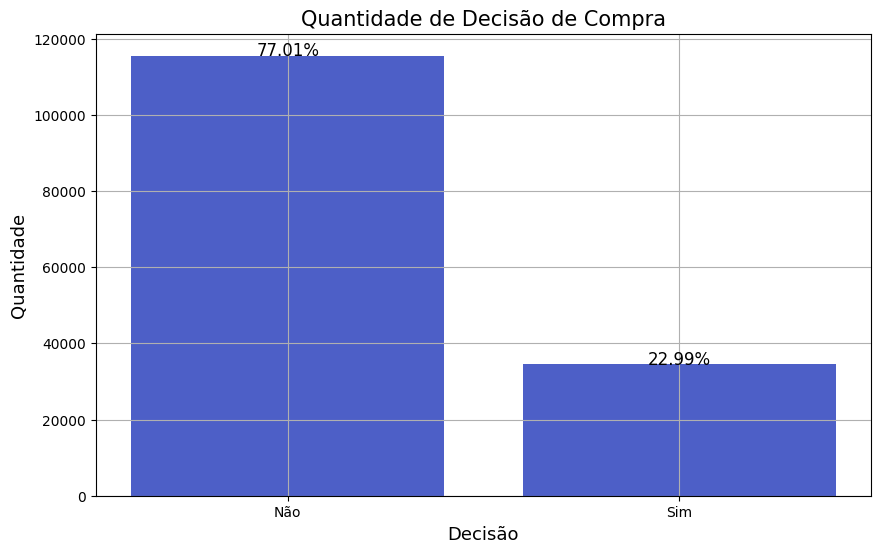

decision
0    115519
1     34481
Name: count, dtype: int64


In [30]:
quantidade = y_train.value_counts() # Conta a quantidade de cada classe na variável alvo do conjunto de treino
porcentagem = (quantidade / quantidade.sum()) * 100 # Calcula a porcentagem de cada classe

plt.figure(figsize=(10, 6))
plt.bar(quantidade.index, quantidade, color="#4D5FC7") # Cria um gráfico de barras da quantidade de decisões de compra

for i, valor in enumerate(quantidade):
    plt.text(i, valor+1, f'{porcentagem.iloc[i]:.2f}%', ha='center', fontsize=12) # Adiciona rótulos de porcentagem acima das barras

plt.title('Quantidade de Decisão de Compra', fontsize=15)
plt.xlabel('Decisão', fontsize=13)
plt.ylabel('Quantidade', fontsize=13)
plt.xticks([0, 1], ['Não', 'Sim'])
plt.grid(True)
plt.show()

print(quantidade)

In [31]:
smote = SMOTE(random_state=8) # Cria uma instância do SMOTE para balanceamento de classes

x_train_balanced, y_train_balanced = smote.fit_resample(x_train_scaled, y_train) # Aplica o SMOTE para balancear as classes no conjunto de treino

print(f'y_train_balanced: {y_train_balanced.value_counts()}') # Exibe a contagem das classes balanceadas no conjunto de treino

y_train_balanced: decision
0    115519
1    115519
Name: count, dtype: int64


Finalizando a etapa do pré-processamento dos dados, é importante verificar se a base de treino Y possuem valores balanceados, isso é, que os resultados possíveis possuam mesma quantidade. Isso se deve pois é durante o treinamento que o modelo identificar os padrões para realizar as classificações e previsões de cada resultado possível, então se um valor for muito mais prevalente na base de treino, o modelo se ajustará muito bem a ele apenas e não conseguirá prever outros resultados possíveis ao se deparar com novas informações. Para evitar essa situação, o modelo deve aprender os padrões de cada valor da variável dependente em mesma quantidade, sendo necessário realizar um balanceamento caso haja grande desigualdade. 

Analisando o gráfico de barras, foi possível perceber que a maioria dos casos tinha 'decision' igual a 0, ou seja, pessoas que não compraram o imóvel, representando 77% (3/4) de toda base de treino, enquanto os casos que era igual a 1, de clientes que adquiriram a propriedade, é a minoria, de cerca de 23% (1/4), duas vezes menor que a outra possibilidade. Dessa forma, foi necessário utilizar o 'SMOTE', ferramenta que permite o balanceamento da variável alvo através da criação de dados sintéticos da classe minoritária até que sua quantidade seja igual a da majoritária.

É importante ressaltar que esse balanceamento só é feito nas bases de treino, pois as bases de teste devem retratar um cenário real do recebimento de novas informações, como se o modelo já estivesse sendo aplicado oficialmente e estivesse recebendo dados inéditos constantemente, frequentemente desbalanceados. Isso significa que balancear as bases de teste não forneceria previsões realistas, impossibilitando a garantia de modelos eficientes.

## Modelagem

A modelagem é a etapa onde são criados os modelos de "Machine Learning" e passam pela processo de treinamento e, posteriormente, são testados para garantir sua capacidade em prever corretamente se um determinado cliente comprou ou não o imóvel. Para que seja possível alcançar esse objetivo, ter o melhor algoritmo em mãos é essencial e, por isso, utilizar de mais de um modelo em projetos de ciência de dados é uma característica muito frequente, permitindo que métodos distintos de classificação possam ser postos em prática, cada um com vantagens e desvantagens próprias, e, seus resultados, comparados. Com isso, encontrar o melhor modelo que atenda as demandas impostas ser torna uma tarefa mais rápida e simples.

#### Primeiro Modelo: Regressão Logística

In [32]:
rl = LogisticRegression(random_state=7, solver='liblinear') # Instanciando a Regressão Logística
#solver 'liblinear' é adequado para conjuntos de dados binários

rl.fit(x_train_balanced, y_train_balanced) # Treinando o modelo com os dados de treino

train_rl_y_pred = rl.predict(x_train_balanced) # Previsões no conjunto de treino

test_rl_y_pred = rl.predict(x_test_scaled) # Previsões no conjunto de teste

O primeiro modelo feito nessa etapa o de Regressão Logística, adequado para o objetivo desse projeto por ser especialmente eficaz em previsões binárias, ou seja, para quando existem duas possíveis categorias presentes na variável alvo, que nesse caso seriam se a residência foi ou não comprada. Além disso, esse modelo de aprendizado de máquina supervisionado de classificação também foi escolhido por sua simplicidade e fácil interpretação de resultados, com um processamento mais rápido e dinâmico que permite uma entrega muito prática de constantes novas previsões.

A forma como a Regressão Logística funciona é através do cálculo da Função Sigmoide, que calcula a probabilidade da variável alvo pertencer a certa categoria, nesse caso, '0' ou '1', em que o resultado final será um valor entre 0 e 1, em que os resultados maiores que o limite estabelecido são categorizados como '1' e os menores, como '0'.

#### Segundo Modelo: XGBoost

In [33]:
xgboost = xgb.XGBClassifier(random_state=7) # Instanciando o XGBoost

xgboost.fit(x_train_balanced, y_train_balanced)  # Treinando o modelo com os dados de treino

train_xgboost_y_pred = xgboost.predict(x_train_balanced) # Previsões no conjunto de treino

test_xgboost_y_pred = xgboost.predict(x_test_scaled) # Previsões no conjunto de teste

O segundo e último modelo é o XGBoost, que é um método de "Machine Learning" conhecido como "ensemble", onde um grupo de modelos são utilizados para retornar o resultado final mais preciso possível. Por conta de ser composto dessa maneira, o XGBoost é mais custoso computacionalmente, mas é mais otimizado e consegue captar padrões mais discretos que podem passar despercebidos por modelos mais simples, gerando previsões melhores em grande parte dos casos. Além disso, também é mais robusto, o que significa que ter maior capacidade em manter um bom desempenho mesmo quando deparado com dados de menor qualidade, cenário frequente em aplicações de mundo real, e impacto reduzido com variações extremas de valores, os "outliers", que estão presentes em algumas variáveis da base de dados. Por fim, é importante ressaltar que essa otimização e robustez contribuí em combater o "overfitting", obstáculo comum em muitos modelos de aprendizado, que consiste na compreensão excessiva dos dados de treinamento a ponto de classificá-los perfeitamente, mas em detrimento de ser incapaz de prever dados novos e inéditos, tornando-o uma escolha ainda mais indicada.

O processo por trás das previsões feitas pelo XGBoost parte do conceito da "Árvore de Decisão". Essa última consiste em fazer questionamentos usando as variáveis de características e, a partir de cada resposta possível se ramifica em um caminho que pode levar a uma nova pergunta ou a uma previsão de classificação. A primeira pergunta, conhecida como "raiz", é escolhida como o melhor ponto de partida das características da base pelo algoritmo para dividir as informações e gera os primeiros "ramos", as possíveis respostas de cada pergunta, que resultam em "nós", novas pergunta fundada nas variáveis independentes que causam novos ramos, ou em "folhas", que são o resultado final de cada possível caminho e contém as previsões, o que causa uma ramificação similar a uma árvore. Contudo, como já explicado, o XGBoost é um método de "ensemble", então a forma como funciona é mais complexa e segue um método chamado de "gradient boosting" (boosting de gradiente): uma primeira árvore de decisão realiza suas previsões, que são apresentadas a uma nova árvore que irá buscar entender e corrigir os erros que ela teve, gerando novas previsões mais confiáveis, que passaram por esse mesmo procedimento até que seja alcançado um modelo com a melhor capacidade de previsão possível.

## Avaliação

#### Métricas de Avaliação

Com as previsões dos modelos já feitas, chega-se na última etapa do projeto: a avaliação de desempenho de cada modelo feito. Para isso, são utilizadas métricas confiáveis e frequentemente usadas para casos de projetos de classificação, sendo elas:

* **Precision**: A precisão indica a porcentagem de previsões do modelo de uma categoria que são, de fato, daquela classe. Em outras palavras, é a taxa de acerto das previsões feitas em relação a todas as previsões que o modelo realizou para aquela categoria 

* **Recall**: Indica a porcentagem das previsões corretas feitas de uma categoria em relação a todos os casos verdadeiramente pertencentes aquela categoria. Ou seja, é a quantidade de previsões que foram corretamente identificadas em comparação com todos os casos pertencentes a determinada classe

* **F1-Score**: É a média harmônica entre a precisão e o "recall", ou seja, é a junção de ambas as métricas em apenas um valor, permitindo uma visão mais geral da capacidade do modelo em relação a cada classe

* **Accuracy**: É a taxa de acerto das previsões do modelo em relação a todos os casos possíveis, isso é, a porcentagem total de previsões corretas

* **Cross Validation**: Conjunto de valores que indicam o desempenho de modelos iguais aos que estão sendo avaliados, porém ao receber conjuntos de dados de treino e teste da mesma base, mas diferentes entre si, ou seja, recebem as mesmas informações, porém alterando sua ordem e posição. Aqui, foram feitos o padrão de 5 "folds" para a avaliação cruzada e uma média dos valores foi calculada e retornada. Essa métrica garante que o modelo oficial não tenha sofrido de problemas, como enviesamento, por causa da forma como os dados foram estruturados e organizados ao serem passados ao modelo

* **Curva ROC**: Gráfico que visualiza a performance do modelo em todos os possíveis limiares de decisão, onde o eixo Y é a Taxa de Verdadeiros Positivos e o eixo X é a Taxa de Falsos Positivos, ambos indo de 0 a 1. Quanto mais rapidamente a curva sobe no eixo Y, se aproximando de 1, e mais perto de 0 no eixo X ela fica, melhor foi a performance do modelo. Esse gráfico permite garantir que as previsões sendo feitas são mais eficazes que um chute ao certificar que a curva não seja uma diagonal perfeita ou, ainda pior, menos eficaz que um chute, sendo mais próxima ao 1 do eixo X e 0 do eixo Y

* **AUC Score**: É a área sob a curva ROC, ou seja, o valor único que resume o desempenho da curva ROC e indica e explica o seu comportamento. Indica o quão bem o modelo consegue distinguir entre as classes

Além dessa métricas, foram criadas também gráficos de **Matriz de Confusão**, que são uma demonstração visual das classificações que o modelo vez, mostrando a quantidade numérica de previsões feitas para cada categoria, quantas estavam corretas e quantas foram categorizadas incorretamente e para qual categoria elas foram previstas.

Com as métricas explicadas, é possível partir para a avaliação específica dos resultados de cada modelo.

#### Funções e Ferramentas para Avaliação

In [34]:
def criar_matriz_confusao(y_true, y_pred, modelo, conjunto): # Função para criar e exibir a matriz de confusão
    cm = confusion_matrix(y_true, y_pred) # Calcula a matriz de confusão
    labels = ['Não', 'Sim'] # Define os rótulos para os eixos

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels) # "fmt='d'" garante que os números sejam inteiros
    plt.xlabel('Previsto', fontsize=14)
    plt.ylabel('Real', fontsize=14)
    plt.title(f'Matriz de Confusão - {modelo} ({conjunto})', fontsize=16)
    plt.show()

def criar_auc_roc(y_true, y_scores, modelo, conjunto): # Função para criar e exibir a curva AUC-ROC
    fpr, tpr, thresholds = roc_curve(y_true, y_scores) # Calcula a curva ROC
    auc_roc = roc_auc_score(y_true, y_scores) # Calcula a área sob a curva ROC

    plt.figure(figsize=(10, 6)) # Define o tamanho da figura
    plt.plot(fpr, tpr, color='#4D5FC7', label=f'AUC = {auc_roc:.2f}') # Plota a curva ROC
    plt.plot([0, 1], [0, 1], color='red', linestyle='--') # Plota a linha de referência
    plt.title(f'Curva ROC - {modelo} ({conjunto})', fontsize=16) # Título do gráfico
    plt.xlabel('Taxa de Falsos Positivos', fontsize=14) # Rótulo do eixo x
    plt.ylabel('Taxa de Verdadeiros Positivos', fontsize=14) # Rótulo do eixo y
    plt.legend(loc='lower right', fontsize=12) # Adiciona a legenda
    plt.grid(True) # Adiciona uma grade ao gráfico
    plt.show() # Exibe o gráfico

folds = 5 # Define o número de folds para validação cruzada
cross_validation = KFold(n_splits=folds, shuffle=True, random_state=7) # Cria uma instância do KFold para validação cruzada com embaralhamento dos dados

### Primeira Avaliação: Regressão Logística

#### Treino


Relatório:
              precision    recall  f1-score   support

           0       0.96      0.94      0.95    115519
           1       0.94      0.96      0.95    115519

    accuracy                           0.95    231038
   macro avg       0.95      0.95      0.95    231038
weighted avg       0.95      0.95      0.95    231038


Cross Validation: 0.95


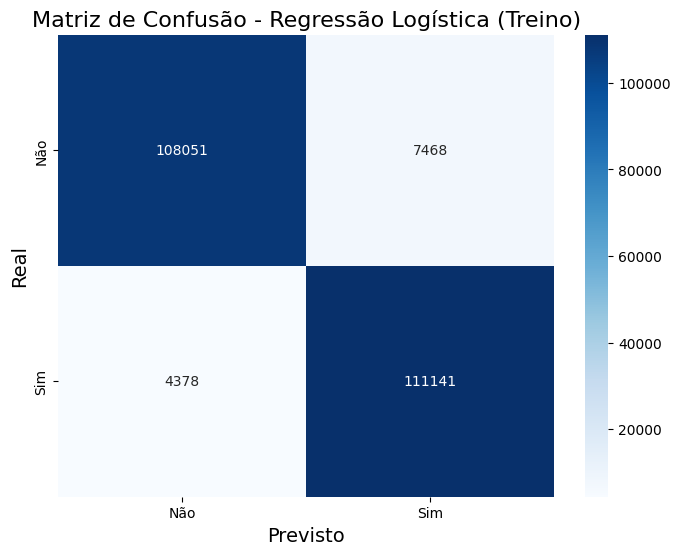

In [35]:
relatorio_rl_train = classification_report(y_train_balanced, train_rl_y_pred) # Relatório de classificação para o conjunto de treino
cross_validation_rl_train = cross_val_score(rl, x_train_balanced, y_train_balanced, cv=cross_validation) # Validação cruzada para o modelo de Regressão Logística no conjunto de treino

print(f'\nRelatório:\n{relatorio_rl_train}') 
print(f'\nCross Validation: {cross_validation_rl_train.mean():.2f}')

criar_matriz_confusao(y_train_balanced, train_rl_y_pred, 'Regressão Logística', 'Treino') # Chama a função para criar a matriz de confusão

#### Teste


Relatório:
              precision    recall  f1-score   support

           0       0.98      0.93      0.96     38413
           1       0.81      0.94      0.87     11587

    accuracy                           0.94     50000
   macro avg       0.90      0.94      0.91     50000
weighted avg       0.94      0.94      0.94     50000



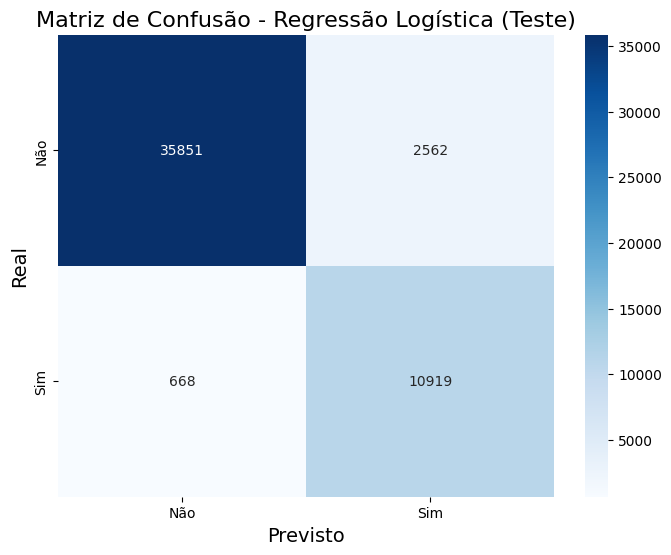

In [36]:
relatorio_rl_test = classification_report(y_test, test_rl_y_pred) # Relatório de classificação para o conjunto de teste
cross_validation_rl_test = cross_val_score(rl, x_train_balanced, y_train_balanced, cv=cross_validation) # Validação cruzada para o modelo de Regressão Logística no conjunto de teste

print(f'\nRelatório:\n{relatorio_rl_test}')

criar_matriz_confusao(y_test, test_rl_y_pred, 'Regressão Logística', 'Teste') 

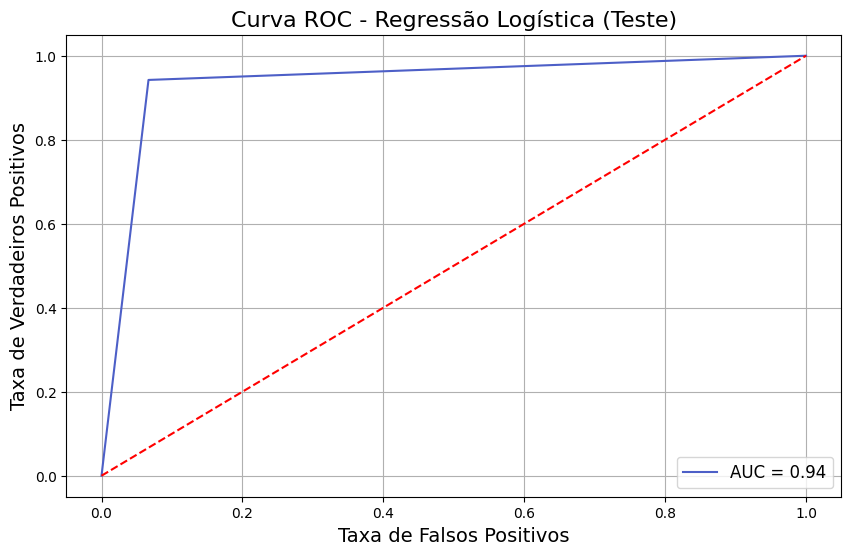

In [37]:
criar_auc_roc(y_test, test_rl_y_pred, 'Regressão Logística', 'Teste') # Chama a função para criar a curva AUC-ROC

Os resultados de treino do primeiro modelo de Regressão Logística mostram que a sua capacidade de previsão foi muito elevada e equilibrada, com um 'F1-Score' de 0.95 tanto para os casos de compradores quanto para os não compradores, com a matriz de confusão evidenciando mais acertos para os aqueles em que 'decision' = 1, mas menos erros para quando é igual 0. Contudo, no relatório dos resultados de teste, é possível notar que as métricas são diferentes: para as previsões de não compradores, a precisão subiu de 0.96 para 0.98, mas o 'recall' caiu de 0.94 para 0.93, o que indica que em dados inéditos, o modelo foi mais capaz de prever corretamente os casos pertencentes à categoria 0, mas teve uma leve dificuldade de identificá-los em toda a base, resultando no 'F1-Score' de 0.96. 

Por outro lado, para as previsões de clientes que adquiriram o imóvel, é evidente a queda da precisão, que foi de 0.94 para 0.81, e do 'recall', de 0.96 para 0.94, reduzindo o 'F1-Score' para 0.87. Isso significa que, com novas informações, a habilidade de identificar os compradores e corretamente categorizá-los foi bem inferior, não somente em comparação aos não compradores, como também em relação aos resultados de treino. Isso fica ainda mais evidente na matriz de confusão, que mostra que pouquíssimos casos de não compradores foram previstos incorretamente, enquanto o modelo classificou muito mais clientes compradores na categoria errada.

É possível afirmar, então, que ocorreu um leve "overfitting" na Regressão Logística, principalmente para os clientes que compraram, já que os resultados de treino foram significativamente melhores para esse cenário, o que indica que o algoritmo se adaptou exageradamente para esses dados. Ainda assim, os resultados finais foram excelentes, com um acurácia geral alta e o gráfico da curva ROC evidenciando um AUC de 0.94, indicando que o algoritmo consegue distinguir muito bem os casos.


### Segunda Avaliação: XGBoost

#### Treino


Relatório:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    115519
           1       1.00      1.00      1.00    115519

    accuracy                           1.00    231038
   macro avg       1.00      1.00      1.00    231038
weighted avg       1.00      1.00      1.00    231038


Cross Validation: 1.00


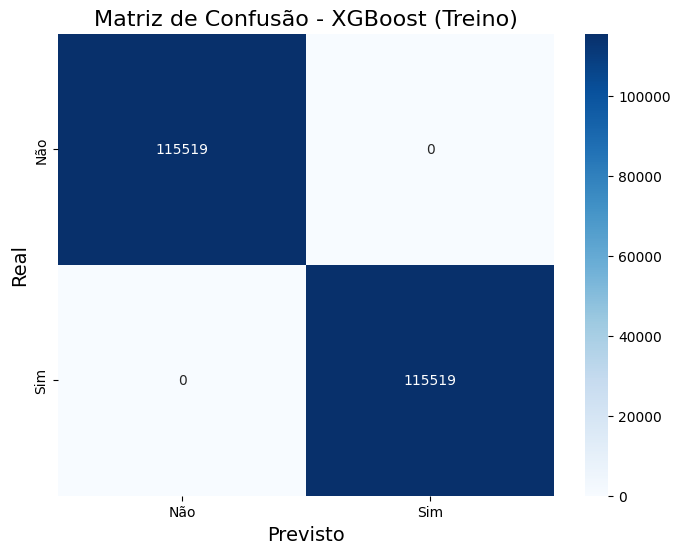

In [38]:
relatorio_xgboost_train = classification_report(y_train_balanced, train_xgboost_y_pred) # Relatório de classificação para o conjunto de treino
cross_validation_xgboost_train = cross_val_score(xgboost, x_train_balanced, y_train_balanced, cv=cross_validation) # Validação cruzada para o modelo XGBoost no conjunto de treino

print(f'\nRelatório:\n{relatorio_xgboost_train}')
print(f'\nCross Validation: {cross_validation_xgboost_train.mean():.2f}')

criar_matriz_confusao(y_train_balanced, train_xgboost_y_pred, 'XGBoost', 'Treino') # Cria e exibe a matriz de confusão para o modelo XGBoost no conjunto de treino

#### Teste


Relatório:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     38413
           1       1.00      1.00      1.00     11587

    accuracy                           1.00     50000
   macro avg       1.00      1.00      1.00     50000
weighted avg       1.00      1.00      1.00     50000



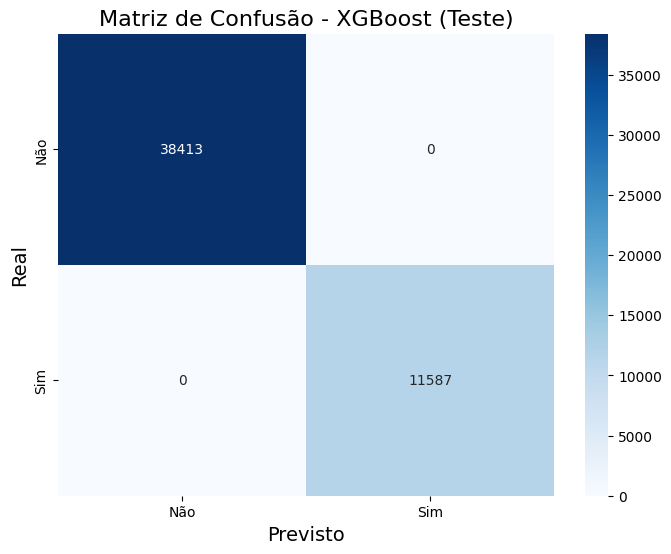

In [39]:
relatorio_xgboost_test = classification_report(y_test, test_xgboost_y_pred) # Relatório de classificação para o conjunto de teste
cross_validation_xgboost_test = cross_val_score(xgboost, x_train_balanced, y_train_balanced, cv=cross_validation) # Validação cruzada para o modelo XGBoost no conjunto de teste

print(f'\nRelatório:\n{relatorio_xgboost_test}')

criar_matriz_confusao(y_test, test_xgboost_y_pred, 'XGBoost', 'Teste') # Cria e exibe a matriz de confusão para o modelo XGBoost no conjunto de teste

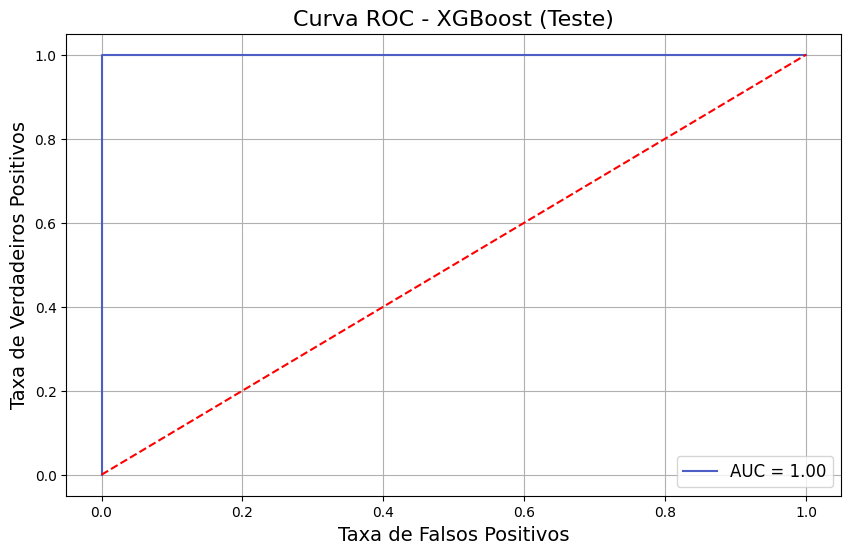

In [40]:
criar_auc_roc(y_test, test_xgboost_y_pred, 'XGBoost', 'Teste')

Os resultados do segundo modelo, XGBoost, foram iguais tanto para os dados de treino quanto para dados de teste: todas as previsões foram corretas. Todas as principais métricas tiveram os melhores resultados, o que indica que o modelo não teve dificuldades em distinguir entre as possíveis categorias e classificá-las corretamente.

Normalmente, casos assim são extremamente difíceis de acontecer e muitas vezes podem indicar problemas no modelo, como "overfitting". Contudo, vendo que os resultados de um modelo mais simples, a Regressão Logística, foram excelentes, o XGBoost, que é mais otimizado e robusto, feito para contornar obstáculos comuns em "Machine Learning" para resultar nas melhores previsões possíveis, ter esse desempenho não indica uma anomalia, mas uma boa configuração do algoritmo, base de dados completa e com informações relevantes, além de um eficaz pré-processamento e limpeza dos dados.

# Conclusão

#### Importância das Features

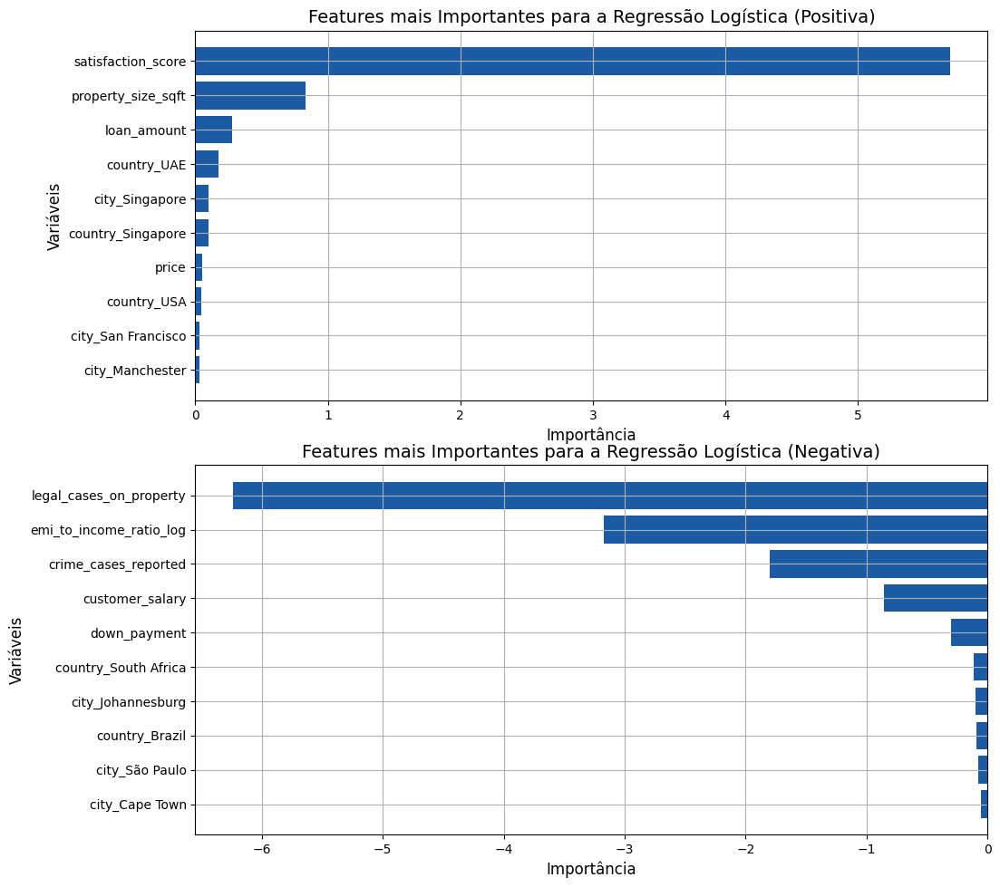

In [41]:
coeficientes_rl = rl.coef_[0] # Obtém os coeficientes do modelo de Regressão Logística para verificar a importância das features

feature_importance_rl = pd.DataFrame({ # Cria um DataFrame para armazenar a importância das features
    'Variável': x_train.columns,
    'Coeficiente': coeficientes_rl
})

feature_importance_rl = feature_importance_rl.sort_values(by='Coeficiente', ascending=False) # Ordena o DataFrame pela importância das features

feature_importance_rl_pos = feature_importance_rl.head(10).sort_values(by='Coeficiente', ascending=True) # Seleciona as 10 features mais importantes (positivas) e ordena para visualização

feature_importance_rl_neg = feature_importance_rl.tail(10) # Seleciona as 10 features menos importantes (negativas)

fig, ((ax1, ax2)) = plt.subplots(2, 1, figsize=(10, 10)) # Cria subplots para visualização
fig.tight_layout(pad=3.0) # Ajusta o layout dos subplots para melhor espaçamento

ax1.barh(feature_importance_rl_pos['Variável'], feature_importance_rl_pos['Coeficiente'], color="#1B5BA3") # Plota as features mais importantes (positivas)
ax1.set_title('Features mais Importantes para a Regressão Logística (Positiva)', fontsize=14)
ax1.set_xlabel('Importância', fontsize=12)
ax1.set_ylabel('Variáveis', fontsize=12)
ax1.grid(True)

ax2.barh(feature_importance_rl_neg['Variável'], feature_importance_rl_neg['Coeficiente'], color="#1B5BA3") # Plota as features menos importantes (negativas)
ax2.set_title('Features mais Importantes para a Regressão Logística (Negativa)', fontsize=14)
ax2.set_xlabel('Importância', fontsize=12)
ax2.set_ylabel('Variáveis', fontsize=12)
ax2.grid(True)

plt.show()

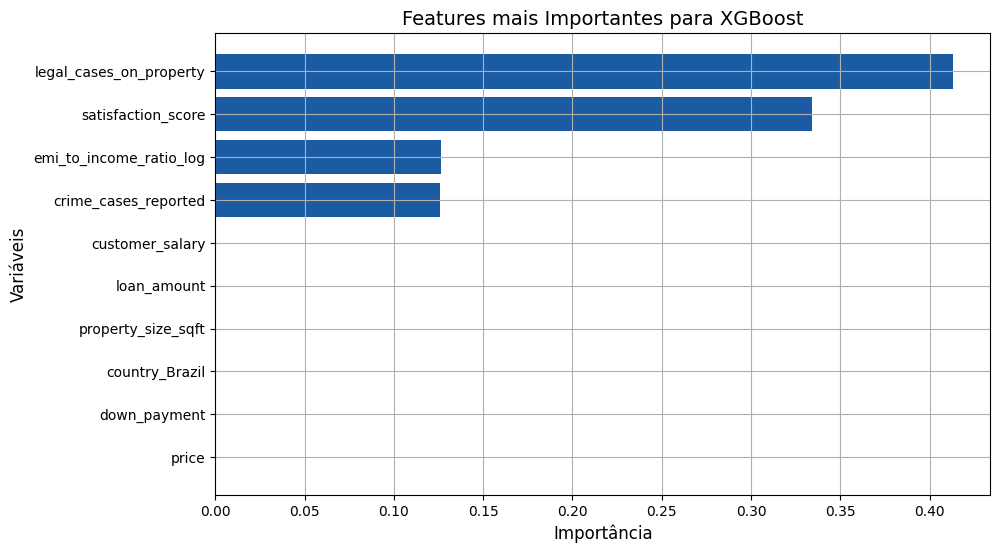

In [42]:
feature_importance_xgboost = xgboost.feature_importances_ # Obtém a importância das features do modelo XGBoost

feature_importance_xgboost = pd.DataFrame( # Cria um DataFrame para armazenar a importância das features do XGBoost
    feature_importance_xgboost, 
    index=x_train.columns, 
    columns=["Importância"]).sort_values(by='Importância', ascending=False)

feature_importance_xgboost_principais = feature_importance_xgboost.head(10).sort_values(by='Importância', ascending=True) # Seleciona as 10 features mais importantes do XGBoost e ordena para visualização

plt.figure(figsize=(10, 6)) 
plt.barh(feature_importance_xgboost_principais.index, feature_importance_xgboost_principais['Importância'], color="#1B5BA3") 
plt.title('Features mais Importantes para XGBoost', fontsize=14) 
plt.xlabel('Importância', fontsize=12)
plt.ylabel('Variáveis', fontsize=12) 
plt.grid(True) 
plt.show()

Os resultados finais de ambos os modelos foram muito gratificantes. O algoritmo de Regressão Logística apresentou uma maior diferença entre a fase de treinamento e a de teste, o que indica maiores dificuldades, mas considerando a simplicidade desse tipo aprendizado supervisionado, sua capacidade de previsões foi excelente. O XGBoost, por sua vez, conseguiu classificar todos os casos corretamente, independentemente da etapa da modelagem que se encontrou, o que mostra sua eficácia para o objetivo do projeto e como sua natural otimização e robustez foram necessárias para esse resultado perfeito, ainda que mais demandante computacionalmente.

Para entender melhor a diferença entre o processamento de cada modelo apresentado, os gráficos de barra acima foram feitos e evidenciam qual a variáveis tiveram maior importância nas previsões feitas pelos modelos. Nos 2 primeiros gráficos, é possível notar as "features" com maior influência, seja ela positiva (quanto maior o valor da variável, maior chance da compra ocorrer) ou negativa (quanto maior o valor da variável, menor a chance da compra ocorrer). As principais variáveis que esse modelo utilizou como critério para realizar suas classificações foram: score de satisfação, disputas legais na propriedade, proporção de EMI para renda, quantidade de casos criminais próximos à propriedade, salário do cliente, tamanho da residência, valor do empréstimo e preço, com as duas primeiras listadas tendo a maior importância (a primeira, positiva, e a segunda, negativa) e outras variáveis tendo alguma importância mas em quantidade menores, como o país ou cidade em que o imóvel se encontra.

Já para o XGBoost, por ser um modelo baseado em árvore de decisão, mede a importância das variáveis de acordo com sua relevância para melhorar o desempenho e processamento do algoritmo, independentemente se é uma força negativa ou positiva. Isso faz com que, diferente da Regressão Logística, que utiliza de coeficientes positivos e negativos para medir o impacto e direção que a "feature" tem na variável alvo (valores mais próximos de 0 indicam pouco impacto), o cálculo da importância do XGBoost possui apenas valores positivos. Assim, é mais fácil entender quais as variáveis que tiveram peso nas previsões, sendo elas 4: se há disputas legais na propriedade, o score de satisfação do cliente, a quantidade de casos criminais reportados próximos ao imóvel e a proporção de EMI para renda.

É possível perceber, dessa maneira, que ambos os modelos compartilham dessas 4 variáveis entre as que tiveram influência significativa no processamento dos algoritmos, mas enquanto o primeiro modelo evidenciou ter dado mais importância para outras variáveis, o segundo não realizou o mesmo processo, com as outras colunas da base tendo uma importância praticamente nula. Vendo que o XGBoost obteve resultados melhores, o modelo de Regressão Logística sofreu de um excesso de informações e teve maior dificuldade em identificar quais possuíam maior relevância para o objetivo do projeto, causando maior confusão em suas previsões.

Por fim, a conclusão final é que para identificar clientes compradores e não compradores com maior facilidade, o modelo de XGBoost é a escolha ideal, já que foi capaz de distinguir melhor os padrões e entender quais informações possuíam maior significância. Ainda que ele exija maior poder computacional e possa ter um processo mais lento ao receber constantes dados novos, seu alto desempenho e acurácia compensa por esses fatores. Além disso, não foram necessários realizar configurações mais avançadas, como o ajuste de hiper parâmetros, para obter esse resultado, o que evidencia ainda mais a capacidade do modelo de lidar com novos dados com praticidade.
